# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

Ya existe el subdirectorio o el archivo data.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

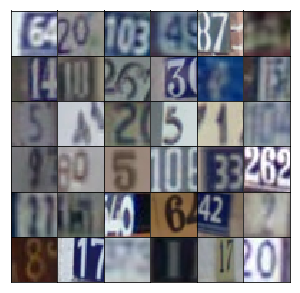

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        x = tf.reshape(x, (-1, 4, 4, 512))
        
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        
        conv1 = tf.layers.conv2d_transpose(x, 256, 5, 2, padding='SAME')
        conv1 = tf.layers.batch_normalization(conv1, training=training)
        conv1 = tf.maximum(alpha * conv1, conv1)
        
        conv2 = tf.layers.conv2d_transpose(conv1, 128, 5, 2, padding='SAME')
        conv2 = tf.layers.batch_normalization(conv2, training=training)
        conv2 = tf.maximum(alpha * conv2, conv2)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv2, output_dim, 5, 2, padding='SAME')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        
        # Input layer is 32x32x3
        conv1 = tf.layers.conv2d(x, 64, 5, 2, padding='SAME')
        conv1 = tf.maximum(alpha * conv1, conv1)
        
        conv2 = tf.layers.conv2d(conv1, 128, 5, 2, padding='SAME')
        conv2 = tf.layers.batch_normalization(conv2, training=True)
        conv2 = tf.maximum(alpha * conv2, conv2)
        
        conv3 = tf.layers.conv2d(conv2, 256, 5, 2, padding='SAME')
        conv3 = tf.layers.batch_normalization(conv3, training=True)
        conv3 = tf.maximum(alpha * conv3, conv3)
        
        flatten = tf.reshape(conv3, (-1, 4*4*256))
        logits = tf.layers.dense(flatten, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 20
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 1.1334... Generator Loss: 0.8015
Epoch 1/20... Discriminator Loss: 0.2638... Generator Loss: 2.3293
Epoch 1/20... Discriminator Loss: 0.1129... Generator Loss: 2.8288
Epoch 1/20... Discriminator Loss: 0.1215... Generator Loss: 2.8495
Epoch 1/20... Discriminator Loss: 0.1474... Generator Loss: 2.9290
Epoch 1/20... Discriminator Loss: 0.1897... Generator Loss: 2.2989
Epoch 1/20... Discriminator Loss: 0.7622... Generator Loss: 2.6162
Epoch 1/20... Discriminator Loss: 0.9990... Generator Loss: 1.0907
Epoch 1/20... Discriminator Loss: 0.8837... Generator Loss: 1.7455
Epoch 1/20... Discriminator Loss: 0.5528... Generator Loss: 2.0158


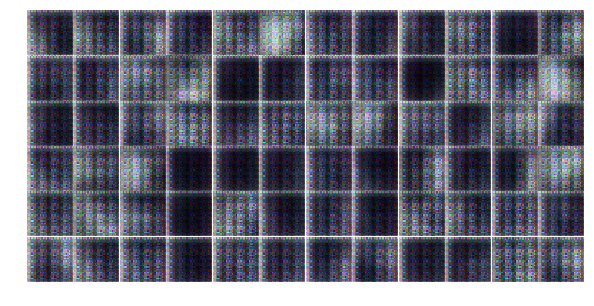

Epoch 1/20... Discriminator Loss: 0.7458... Generator Loss: 2.9900
Epoch 1/20... Discriminator Loss: 0.5136... Generator Loss: 1.5001
Epoch 1/20... Discriminator Loss: 0.8464... Generator Loss: 0.8735
Epoch 1/20... Discriminator Loss: 0.3317... Generator Loss: 2.5426
Epoch 1/20... Discriminator Loss: 1.0031... Generator Loss: 1.2154
Epoch 1/20... Discriminator Loss: 0.5932... Generator Loss: 1.1886
Epoch 1/20... Discriminator Loss: 0.2544... Generator Loss: 2.5863
Epoch 1/20... Discriminator Loss: 0.8362... Generator Loss: 2.9786
Epoch 1/20... Discriminator Loss: 0.9924... Generator Loss: 3.9483
Epoch 1/20... Discriminator Loss: 0.1170... Generator Loss: 3.7623


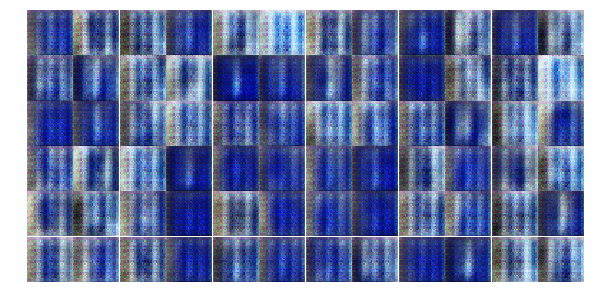

Epoch 1/20... Discriminator Loss: 0.2375... Generator Loss: 2.7495
Epoch 1/20... Discriminator Loss: 0.4711... Generator Loss: 3.0529
Epoch 1/20... Discriminator Loss: 2.5872... Generator Loss: 0.3727
Epoch 1/20... Discriminator Loss: 1.0402... Generator Loss: 1.3801
Epoch 1/20... Discriminator Loss: 1.3888... Generator Loss: 1.0047
Epoch 1/20... Discriminator Loss: 0.9614... Generator Loss: 1.5617
Epoch 1/20... Discriminator Loss: 0.4222... Generator Loss: 1.6896
Epoch 1/20... Discriminator Loss: 0.4782... Generator Loss: 2.0459
Epoch 1/20... Discriminator Loss: 0.3311... Generator Loss: 2.2657
Epoch 1/20... Discriminator Loss: 0.2599... Generator Loss: 2.5529


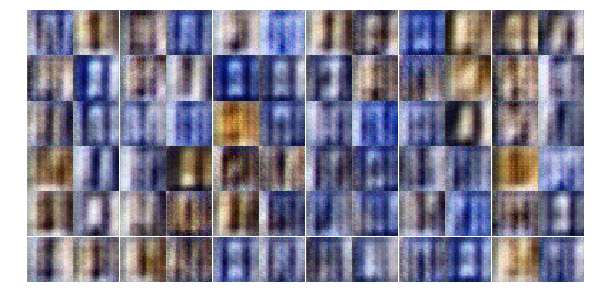

Epoch 1/20... Discriminator Loss: 0.4101... Generator Loss: 1.6238
Epoch 1/20... Discriminator Loss: 0.2801... Generator Loss: 2.6299
Epoch 1/20... Discriminator Loss: 0.5783... Generator Loss: 1.8426
Epoch 1/20... Discriminator Loss: 0.8988... Generator Loss: 2.1857
Epoch 1/20... Discriminator Loss: 0.5359... Generator Loss: 1.6602
Epoch 1/20... Discriminator Loss: 0.5320... Generator Loss: 2.0002
Epoch 1/20... Discriminator Loss: 0.3927... Generator Loss: 1.8841
Epoch 1/20... Discriminator Loss: 0.6095... Generator Loss: 2.6453
Epoch 1/20... Discriminator Loss: 0.2862... Generator Loss: 2.3077
Epoch 1/20... Discriminator Loss: 0.6040... Generator Loss: 2.3988


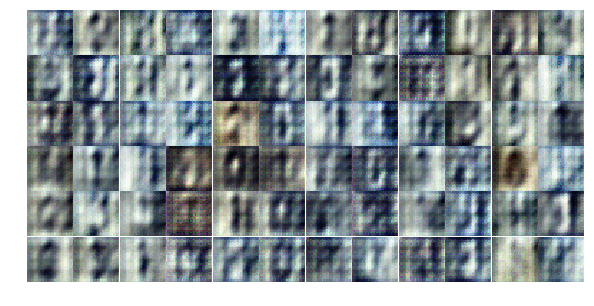

Epoch 1/20... Discriminator Loss: 0.6261... Generator Loss: 1.7438
Epoch 1/20... Discriminator Loss: 0.5086... Generator Loss: 1.5430
Epoch 1/20... Discriminator Loss: 0.4707... Generator Loss: 2.1655
Epoch 1/20... Discriminator Loss: 0.3460... Generator Loss: 2.0769
Epoch 1/20... Discriminator Loss: 0.2117... Generator Loss: 2.1993
Epoch 1/20... Discriminator Loss: 0.2249... Generator Loss: 2.0246
Epoch 1/20... Discriminator Loss: 0.2801... Generator Loss: 2.4928
Epoch 1/20... Discriminator Loss: 0.3865... Generator Loss: 2.8097
Epoch 1/20... Discriminator Loss: 1.5608... Generator Loss: 0.3886
Epoch 1/20... Discriminator Loss: 0.4229... Generator Loss: 1.8953


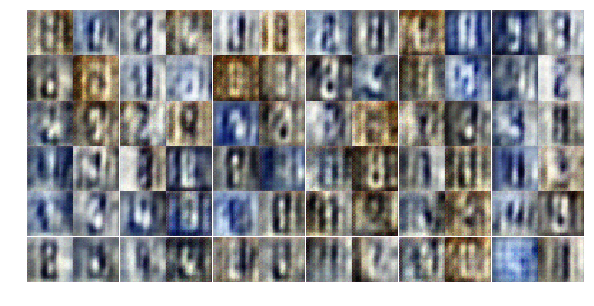

Epoch 1/20... Discriminator Loss: 0.2625... Generator Loss: 2.4592
Epoch 1/20... Discriminator Loss: 0.4991... Generator Loss: 1.4077
Epoch 1/20... Discriminator Loss: 0.2552... Generator Loss: 3.3126
Epoch 1/20... Discriminator Loss: 0.1978... Generator Loss: 2.4189
Epoch 1/20... Discriminator Loss: 1.6778... Generator Loss: 0.3892
Epoch 1/20... Discriminator Loss: 0.4571... Generator Loss: 1.5147
Epoch 1/20... Discriminator Loss: 0.3327... Generator Loss: 3.9834
Epoch 2/20... Discriminator Loss: 1.2414... Generator Loss: 4.5243
Epoch 2/20... Discriminator Loss: 0.7984... Generator Loss: 1.7462
Epoch 2/20... Discriminator Loss: 0.2487... Generator Loss: 2.8376


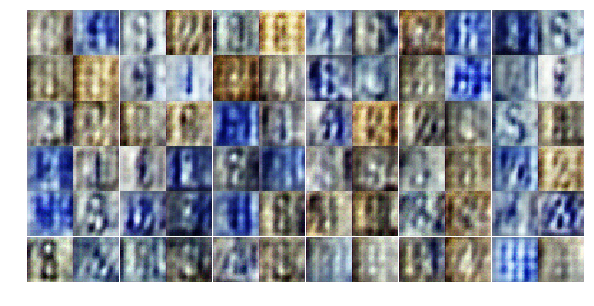

Epoch 2/20... Discriminator Loss: 0.9039... Generator Loss: 1.1143
Epoch 2/20... Discriminator Loss: 0.2593... Generator Loss: 2.5350
Epoch 2/20... Discriminator Loss: 1.1083... Generator Loss: 0.5743
Epoch 2/20... Discriminator Loss: 0.7947... Generator Loss: 0.8387
Epoch 2/20... Discriminator Loss: 0.8876... Generator Loss: 1.2182
Epoch 2/20... Discriminator Loss: 0.7497... Generator Loss: 1.8608
Epoch 2/20... Discriminator Loss: 1.0279... Generator Loss: 0.8301
Epoch 2/20... Discriminator Loss: 0.6325... Generator Loss: 2.0817
Epoch 2/20... Discriminator Loss: 0.7920... Generator Loss: 1.0929
Epoch 2/20... Discriminator Loss: 1.0639... Generator Loss: 1.0089


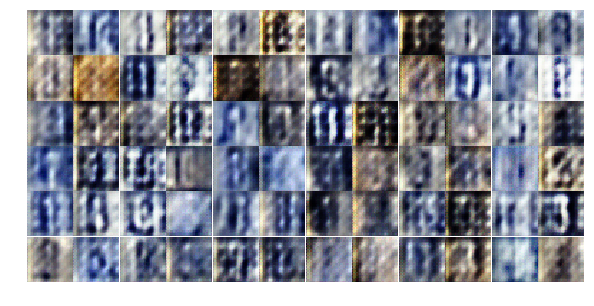

Epoch 2/20... Discriminator Loss: 0.7592... Generator Loss: 1.3992
Epoch 2/20... Discriminator Loss: 0.9219... Generator Loss: 1.4739
Epoch 2/20... Discriminator Loss: 0.9477... Generator Loss: 1.5052
Epoch 2/20... Discriminator Loss: 0.5875... Generator Loss: 1.8698
Epoch 2/20... Discriminator Loss: 0.9893... Generator Loss: 2.6411
Epoch 2/20... Discriminator Loss: 0.7101... Generator Loss: 1.3678
Epoch 2/20... Discriminator Loss: 1.0573... Generator Loss: 1.3131
Epoch 2/20... Discriminator Loss: 0.8437... Generator Loss: 1.6410
Epoch 2/20... Discriminator Loss: 0.9670... Generator Loss: 1.1316
Epoch 2/20... Discriminator Loss: 0.9418... Generator Loss: 1.1713


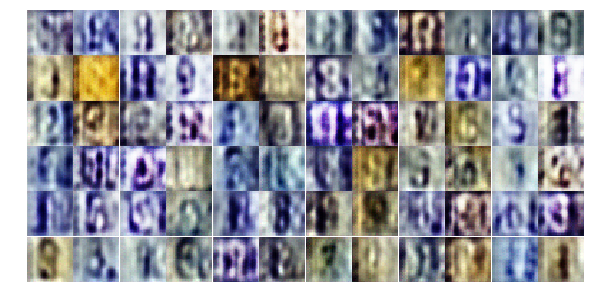

Epoch 2/20... Discriminator Loss: 0.6963... Generator Loss: 1.2402
Epoch 2/20... Discriminator Loss: 0.9005... Generator Loss: 1.0632
Epoch 2/20... Discriminator Loss: 0.9375... Generator Loss: 1.2230
Epoch 2/20... Discriminator Loss: 0.8871... Generator Loss: 1.3262
Epoch 2/20... Discriminator Loss: 0.9860... Generator Loss: 1.5756
Epoch 2/20... Discriminator Loss: 0.9339... Generator Loss: 1.0711
Epoch 2/20... Discriminator Loss: 0.7898... Generator Loss: 1.3639
Epoch 2/20... Discriminator Loss: 0.7813... Generator Loss: 1.0495
Epoch 2/20... Discriminator Loss: 0.9871... Generator Loss: 0.9875
Epoch 2/20... Discriminator Loss: 0.9020... Generator Loss: 1.1517


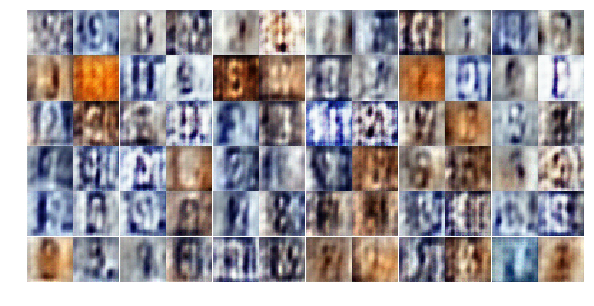

Epoch 2/20... Discriminator Loss: 1.5370... Generator Loss: 0.4204
Epoch 2/20... Discriminator Loss: 1.2822... Generator Loss: 0.9454
Epoch 2/20... Discriminator Loss: 0.7900... Generator Loss: 1.0757
Epoch 2/20... Discriminator Loss: 1.3683... Generator Loss: 0.7048
Epoch 2/20... Discriminator Loss: 0.7275... Generator Loss: 1.3366
Epoch 2/20... Discriminator Loss: 0.6981... Generator Loss: 1.5049
Epoch 2/20... Discriminator Loss: 1.1715... Generator Loss: 1.4361
Epoch 2/20... Discriminator Loss: 0.7046... Generator Loss: 1.6533
Epoch 2/20... Discriminator Loss: 1.0390... Generator Loss: 1.0658
Epoch 2/20... Discriminator Loss: 0.9686... Generator Loss: 1.2283


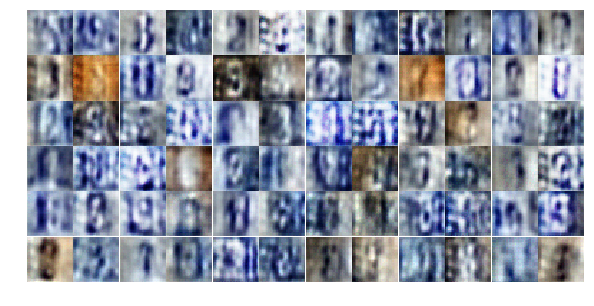

Epoch 2/20... Discriminator Loss: 0.8741... Generator Loss: 1.1704
Epoch 2/20... Discriminator Loss: 1.2083... Generator Loss: 0.7743
Epoch 2/20... Discriminator Loss: 1.0329... Generator Loss: 0.6512
Epoch 2/20... Discriminator Loss: 0.7359... Generator Loss: 1.3908
Epoch 2/20... Discriminator Loss: 1.4361... Generator Loss: 1.4006
Epoch 2/20... Discriminator Loss: 0.6793... Generator Loss: 1.2873
Epoch 2/20... Discriminator Loss: 0.8695... Generator Loss: 1.4409
Epoch 2/20... Discriminator Loss: 1.0397... Generator Loss: 1.0413
Epoch 2/20... Discriminator Loss: 0.7278... Generator Loss: 1.3596
Epoch 2/20... Discriminator Loss: 0.7161... Generator Loss: 1.5919


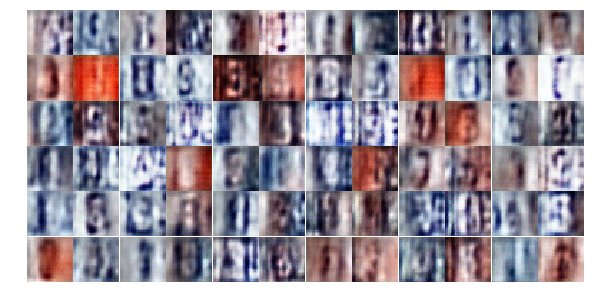

Epoch 2/20... Discriminator Loss: 0.9984... Generator Loss: 1.6635
Epoch 2/20... Discriminator Loss: 0.7731... Generator Loss: 1.3708
Epoch 2/20... Discriminator Loss: 0.8262... Generator Loss: 1.4484
Epoch 2/20... Discriminator Loss: 1.0046... Generator Loss: 1.0135
Epoch 3/20... Discriminator Loss: 0.7703... Generator Loss: 1.4822
Epoch 3/20... Discriminator Loss: 1.1037... Generator Loss: 0.7621
Epoch 3/20... Discriminator Loss: 0.7839... Generator Loss: 1.2170
Epoch 3/20... Discriminator Loss: 0.8995... Generator Loss: 0.9243
Epoch 3/20... Discriminator Loss: 0.7442... Generator Loss: 1.4261
Epoch 3/20... Discriminator Loss: 0.8800... Generator Loss: 0.9402


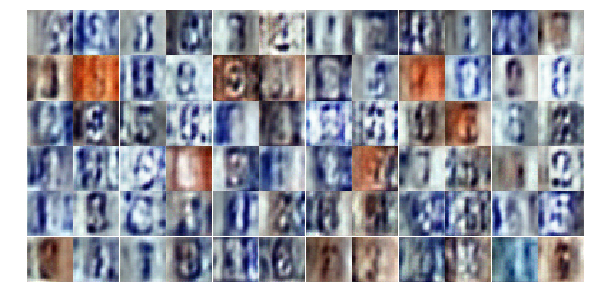

Epoch 3/20... Discriminator Loss: 0.4476... Generator Loss: 1.6711
Epoch 3/20... Discriminator Loss: 0.8051... Generator Loss: 0.8973
Epoch 3/20... Discriminator Loss: 0.9446... Generator Loss: 0.8262
Epoch 3/20... Discriminator Loss: 0.9899... Generator Loss: 0.9990
Epoch 3/20... Discriminator Loss: 0.8960... Generator Loss: 1.2385
Epoch 3/20... Discriminator Loss: 0.9601... Generator Loss: 0.8663
Epoch 3/20... Discriminator Loss: 0.8166... Generator Loss: 1.3276
Epoch 3/20... Discriminator Loss: 0.5380... Generator Loss: 1.7192
Epoch 3/20... Discriminator Loss: 1.2251... Generator Loss: 0.5412
Epoch 3/20... Discriminator Loss: 0.4225... Generator Loss: 2.1030


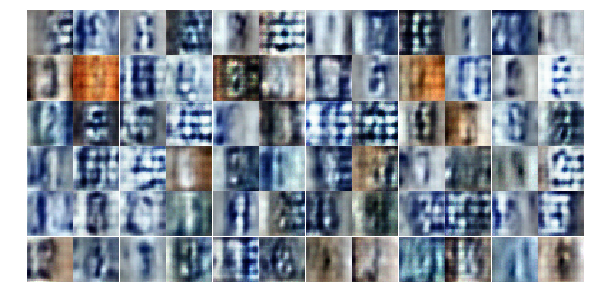

Epoch 3/20... Discriminator Loss: 0.6379... Generator Loss: 1.7668
Epoch 3/20... Discriminator Loss: 1.0947... Generator Loss: 0.6441
Epoch 3/20... Discriminator Loss: 1.0593... Generator Loss: 0.8848
Epoch 3/20... Discriminator Loss: 0.5856... Generator Loss: 1.4626
Epoch 3/20... Discriminator Loss: 1.1004... Generator Loss: 0.6295
Epoch 3/20... Discriminator Loss: 0.9466... Generator Loss: 1.1370
Epoch 3/20... Discriminator Loss: 0.5506... Generator Loss: 2.0777
Epoch 3/20... Discriminator Loss: 0.7118... Generator Loss: 1.9058
Epoch 3/20... Discriminator Loss: 0.7492... Generator Loss: 1.5617
Epoch 3/20... Discriminator Loss: 0.6089... Generator Loss: 1.2006


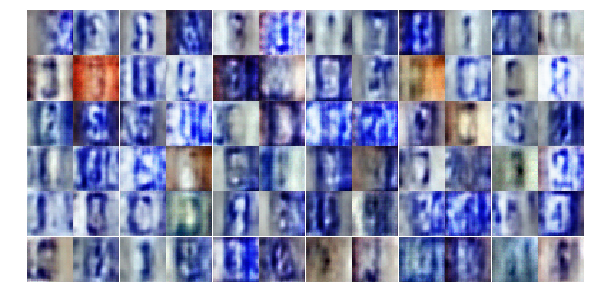

Epoch 3/20... Discriminator Loss: 0.7650... Generator Loss: 1.5108
Epoch 3/20... Discriminator Loss: 0.6771... Generator Loss: 1.4214
Epoch 3/20... Discriminator Loss: 0.8419... Generator Loss: 1.5047
Epoch 3/20... Discriminator Loss: 0.3652... Generator Loss: 2.4303
Epoch 3/20... Discriminator Loss: 0.7195... Generator Loss: 1.5231
Epoch 3/20... Discriminator Loss: 0.8781... Generator Loss: 1.0490
Epoch 3/20... Discriminator Loss: 0.7998... Generator Loss: 1.3344
Epoch 3/20... Discriminator Loss: 0.6169... Generator Loss: 1.8061
Epoch 3/20... Discriminator Loss: 1.1078... Generator Loss: 2.1218
Epoch 3/20... Discriminator Loss: 0.7660... Generator Loss: 1.0319


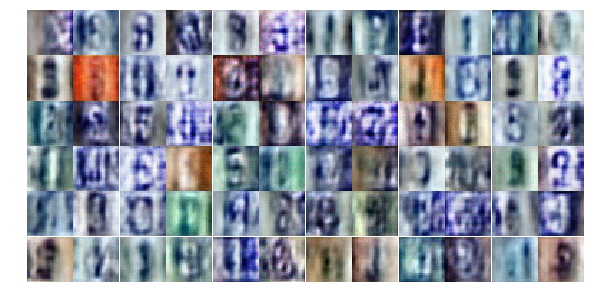

Epoch 3/20... Discriminator Loss: 0.5558... Generator Loss: 1.4325
Epoch 3/20... Discriminator Loss: 0.7428... Generator Loss: 1.3633
Epoch 3/20... Discriminator Loss: 0.6928... Generator Loss: 1.8488
Epoch 3/20... Discriminator Loss: 0.8083... Generator Loss: 0.9915
Epoch 3/20... Discriminator Loss: 0.5320... Generator Loss: 1.5412
Epoch 3/20... Discriminator Loss: 0.6570... Generator Loss: 1.5375
Epoch 3/20... Discriminator Loss: 0.6362... Generator Loss: 1.4017
Epoch 3/20... Discriminator Loss: 0.6000... Generator Loss: 1.2883
Epoch 3/20... Discriminator Loss: 0.7078... Generator Loss: 2.2977
Epoch 3/20... Discriminator Loss: 0.5754... Generator Loss: 1.4526


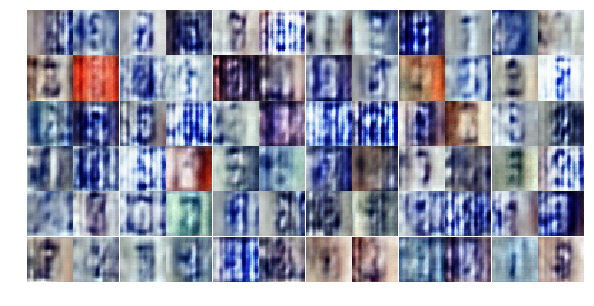

Epoch 3/20... Discriminator Loss: 0.6721... Generator Loss: 1.3134
Epoch 3/20... Discriminator Loss: 0.8813... Generator Loss: 0.8726
Epoch 3/20... Discriminator Loss: 0.6107... Generator Loss: 1.2427
Epoch 3/20... Discriminator Loss: 0.5582... Generator Loss: 1.6282
Epoch 3/20... Discriminator Loss: 0.6609... Generator Loss: 2.1604
Epoch 3/20... Discriminator Loss: 0.3754... Generator Loss: 1.8978
Epoch 3/20... Discriminator Loss: 0.4583... Generator Loss: 1.6705
Epoch 3/20... Discriminator Loss: 0.5523... Generator Loss: 2.6412
Epoch 3/20... Discriminator Loss: 0.7862... Generator Loss: 1.0767
Epoch 3/20... Discriminator Loss: 0.5722... Generator Loss: 1.7257


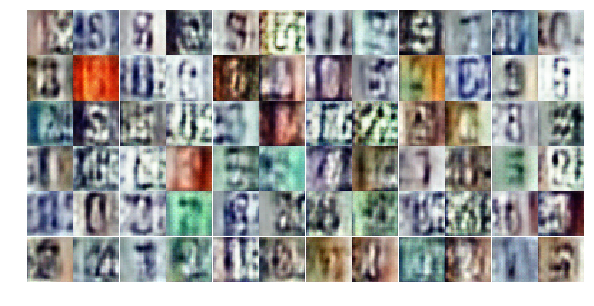

Epoch 3/20... Discriminator Loss: 0.9543... Generator Loss: 0.7505
Epoch 4/20... Discriminator Loss: 0.7154... Generator Loss: 1.4621
Epoch 4/20... Discriminator Loss: 0.9887... Generator Loss: 1.1610
Epoch 4/20... Discriminator Loss: 0.7781... Generator Loss: 0.9837
Epoch 4/20... Discriminator Loss: 0.5641... Generator Loss: 1.4872
Epoch 4/20... Discriminator Loss: 0.7439... Generator Loss: 0.9696
Epoch 4/20... Discriminator Loss: 1.3060... Generator Loss: 0.5151
Epoch 4/20... Discriminator Loss: 1.1220... Generator Loss: 1.1012
Epoch 4/20... Discriminator Loss: 0.9563... Generator Loss: 1.7315
Epoch 4/20... Discriminator Loss: 0.5484... Generator Loss: 1.6078


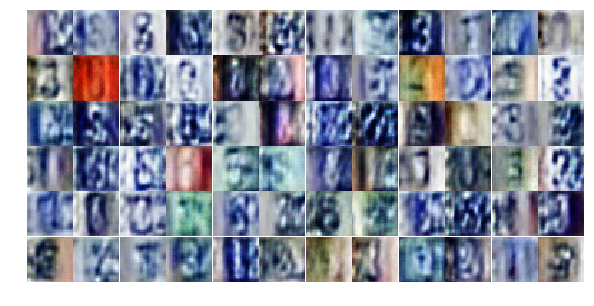

Epoch 4/20... Discriminator Loss: 0.4858... Generator Loss: 1.7755
Epoch 4/20... Discriminator Loss: 0.6983... Generator Loss: 1.1854
Epoch 4/20... Discriminator Loss: 0.7636... Generator Loss: 1.0824
Epoch 4/20... Discriminator Loss: 0.5678... Generator Loss: 2.2808
Epoch 4/20... Discriminator Loss: 0.5945... Generator Loss: 1.1557
Epoch 4/20... Discriminator Loss: 1.3034... Generator Loss: 0.4565
Epoch 4/20... Discriminator Loss: 0.8969... Generator Loss: 0.7424
Epoch 4/20... Discriminator Loss: 0.6984... Generator Loss: 1.2990
Epoch 4/20... Discriminator Loss: 0.5404... Generator Loss: 2.1497
Epoch 4/20... Discriminator Loss: 0.7100... Generator Loss: 1.7236


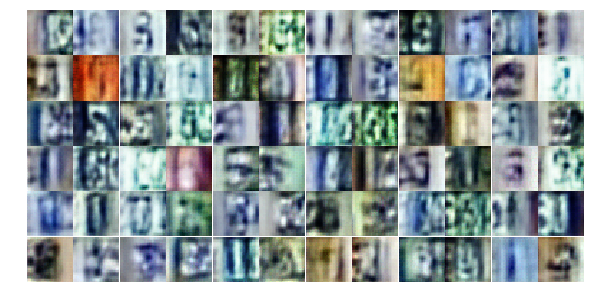

Epoch 4/20... Discriminator Loss: 0.5609... Generator Loss: 1.7271
Epoch 4/20... Discriminator Loss: 0.4137... Generator Loss: 1.5716
Epoch 4/20... Discriminator Loss: 0.4640... Generator Loss: 1.9475
Epoch 4/20... Discriminator Loss: 0.3817... Generator Loss: 1.7588
Epoch 4/20... Discriminator Loss: 0.4412... Generator Loss: 1.5301
Epoch 4/20... Discriminator Loss: 0.5939... Generator Loss: 2.8461
Epoch 4/20... Discriminator Loss: 0.4256... Generator Loss: 1.6345
Epoch 4/20... Discriminator Loss: 0.4589... Generator Loss: 1.3835
Epoch 4/20... Discriminator Loss: 0.2760... Generator Loss: 2.3919
Epoch 4/20... Discriminator Loss: 1.0055... Generator Loss: 2.9300


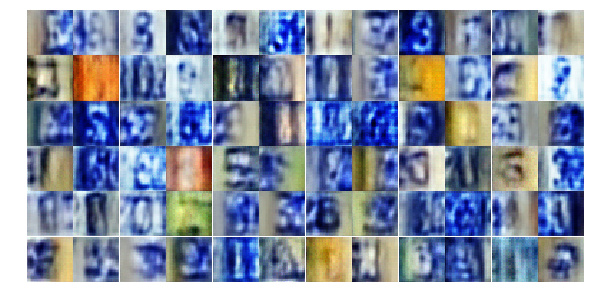

Epoch 4/20... Discriminator Loss: 0.6611... Generator Loss: 1.1479
Epoch 4/20... Discriminator Loss: 0.7566... Generator Loss: 0.8752
Epoch 4/20... Discriminator Loss: 0.3319... Generator Loss: 2.0130
Epoch 4/20... Discriminator Loss: 0.3563... Generator Loss: 2.1115
Epoch 4/20... Discriminator Loss: 0.8538... Generator Loss: 2.3258
Epoch 4/20... Discriminator Loss: 0.5309... Generator Loss: 1.2627
Epoch 4/20... Discriminator Loss: 0.4097... Generator Loss: 2.7266
Epoch 4/20... Discriminator Loss: 0.5657... Generator Loss: 1.1330
Epoch 4/20... Discriminator Loss: 0.9734... Generator Loss: 0.5836
Epoch 4/20... Discriminator Loss: 1.4349... Generator Loss: 0.3693


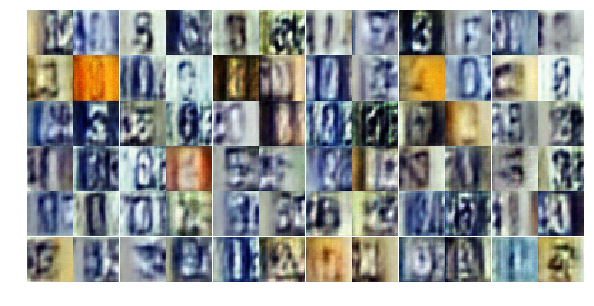

Epoch 4/20... Discriminator Loss: 0.4952... Generator Loss: 1.4016
Epoch 4/20... Discriminator Loss: 0.3880... Generator Loss: 1.6089
Epoch 4/20... Discriminator Loss: 0.4755... Generator Loss: 1.4998
Epoch 4/20... Discriminator Loss: 0.3702... Generator Loss: 1.8896
Epoch 4/20... Discriminator Loss: 0.3172... Generator Loss: 2.0653
Epoch 4/20... Discriminator Loss: 0.5788... Generator Loss: 1.1507
Epoch 4/20... Discriminator Loss: 0.7290... Generator Loss: 0.8389
Epoch 4/20... Discriminator Loss: 1.0238... Generator Loss: 0.9653
Epoch 4/20... Discriminator Loss: 0.5320... Generator Loss: 1.9928
Epoch 4/20... Discriminator Loss: 0.6809... Generator Loss: 1.6493


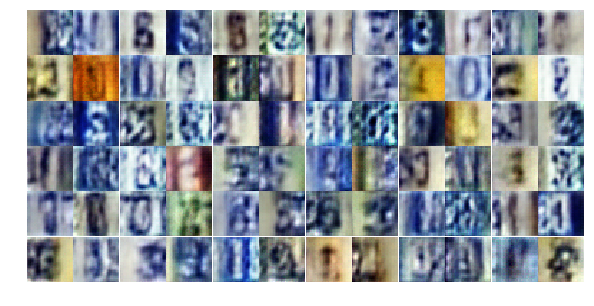

Epoch 4/20... Discriminator Loss: 0.4967... Generator Loss: 1.7993
Epoch 4/20... Discriminator Loss: 0.4106... Generator Loss: 2.4238
Epoch 4/20... Discriminator Loss: 0.4065... Generator Loss: 1.5202
Epoch 4/20... Discriminator Loss: 0.4963... Generator Loss: 1.7010
Epoch 4/20... Discriminator Loss: 0.5263... Generator Loss: 1.3620
Epoch 4/20... Discriminator Loss: 0.3454... Generator Loss: 1.8426
Epoch 4/20... Discriminator Loss: 0.4033... Generator Loss: 1.4688
Epoch 4/20... Discriminator Loss: 0.6453... Generator Loss: 1.0911
Epoch 4/20... Discriminator Loss: 0.3899... Generator Loss: 1.7241
Epoch 5/20... Discriminator Loss: 0.3426... Generator Loss: 1.9538


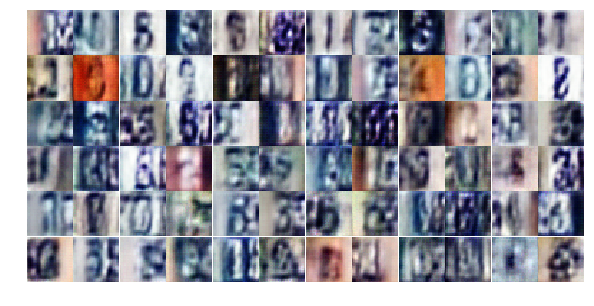

Epoch 5/20... Discriminator Loss: 0.2547... Generator Loss: 2.4885
Epoch 5/20... Discriminator Loss: 0.7219... Generator Loss: 2.8122
Epoch 5/20... Discriminator Loss: 0.6746... Generator Loss: 1.3185
Epoch 5/20... Discriminator Loss: 0.6058... Generator Loss: 1.1227
Epoch 5/20... Discriminator Loss: 0.4480... Generator Loss: 1.5668
Epoch 5/20... Discriminator Loss: 0.6227... Generator Loss: 1.1109
Epoch 5/20... Discriminator Loss: 0.5099... Generator Loss: 1.2870
Epoch 5/20... Discriminator Loss: 0.4710... Generator Loss: 1.3879
Epoch 5/20... Discriminator Loss: 1.0596... Generator Loss: 0.5945
Epoch 5/20... Discriminator Loss: 0.9185... Generator Loss: 2.1234


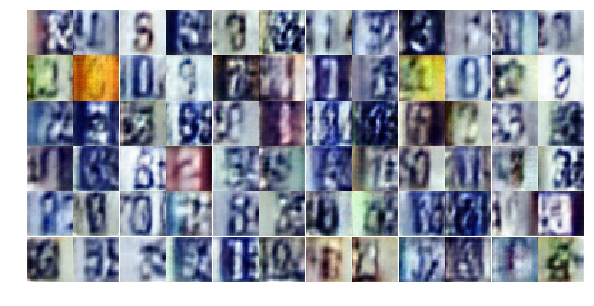

Epoch 5/20... Discriminator Loss: 0.6086... Generator Loss: 1.9240
Epoch 5/20... Discriminator Loss: 0.3388... Generator Loss: 1.9103
Epoch 5/20... Discriminator Loss: 0.3376... Generator Loss: 2.0076
Epoch 5/20... Discriminator Loss: 0.7597... Generator Loss: 0.9175
Epoch 5/20... Discriminator Loss: 1.6498... Generator Loss: 4.0326
Epoch 5/20... Discriminator Loss: 0.6583... Generator Loss: 2.3495
Epoch 5/20... Discriminator Loss: 0.4598... Generator Loss: 1.6408
Epoch 5/20... Discriminator Loss: 0.4833... Generator Loss: 1.5228
Epoch 5/20... Discriminator Loss: 0.4115... Generator Loss: 1.5808
Epoch 5/20... Discriminator Loss: 0.3090... Generator Loss: 2.1163


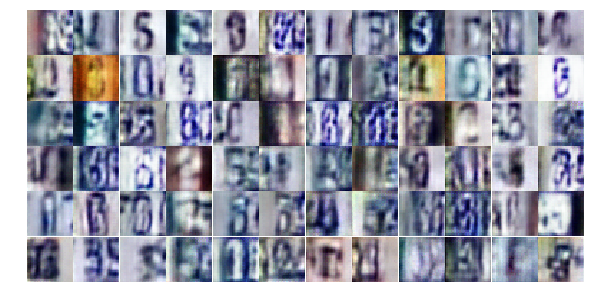

Epoch 5/20... Discriminator Loss: 0.3428... Generator Loss: 1.6898
Epoch 5/20... Discriminator Loss: 0.4241... Generator Loss: 2.1485
Epoch 5/20... Discriminator Loss: 0.6472... Generator Loss: 0.9990
Epoch 5/20... Discriminator Loss: 0.7103... Generator Loss: 1.0080
Epoch 5/20... Discriminator Loss: 0.6374... Generator Loss: 1.0950
Epoch 5/20... Discriminator Loss: 0.4835... Generator Loss: 1.3491
Epoch 5/20... Discriminator Loss: 1.6354... Generator Loss: 0.3317
Epoch 5/20... Discriminator Loss: 0.7853... Generator Loss: 1.5289
Epoch 5/20... Discriminator Loss: 1.1103... Generator Loss: 0.5781
Epoch 5/20... Discriminator Loss: 0.5977... Generator Loss: 1.2440


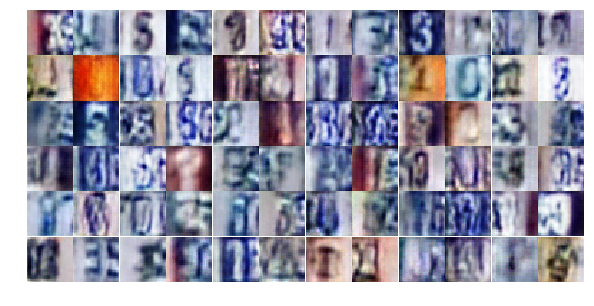

Epoch 5/20... Discriminator Loss: 0.8578... Generator Loss: 0.7676
Epoch 5/20... Discriminator Loss: 0.5938... Generator Loss: 1.2646
Epoch 5/20... Discriminator Loss: 0.5051... Generator Loss: 1.9000
Epoch 5/20... Discriminator Loss: 0.3182... Generator Loss: 1.9507
Epoch 5/20... Discriminator Loss: 0.4364... Generator Loss: 1.7047
Epoch 5/20... Discriminator Loss: 0.4938... Generator Loss: 1.3155
Epoch 5/20... Discriminator Loss: 1.0487... Generator Loss: 0.5890
Epoch 5/20... Discriminator Loss: 0.5610... Generator Loss: 1.2508
Epoch 5/20... Discriminator Loss: 0.8350... Generator Loss: 0.7977
Epoch 5/20... Discriminator Loss: 0.8582... Generator Loss: 0.7673


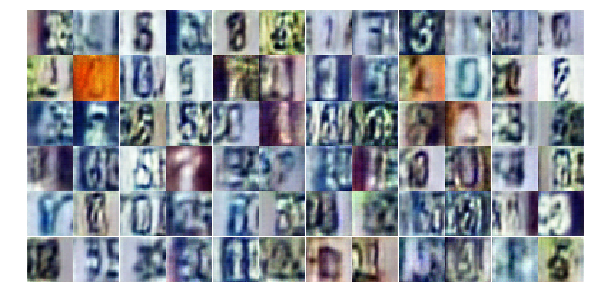

Epoch 5/20... Discriminator Loss: 0.9929... Generator Loss: 0.6977
Epoch 5/20... Discriminator Loss: 0.8396... Generator Loss: 0.7372
Epoch 5/20... Discriminator Loss: 1.2165... Generator Loss: 0.4541
Epoch 5/20... Discriminator Loss: 0.5256... Generator Loss: 2.0648
Epoch 5/20... Discriminator Loss: 0.7040... Generator Loss: 1.6157
Epoch 5/20... Discriminator Loss: 0.9419... Generator Loss: 0.6950
Epoch 5/20... Discriminator Loss: 0.6526... Generator Loss: 1.2618
Epoch 5/20... Discriminator Loss: 0.4983... Generator Loss: 1.6265
Epoch 5/20... Discriminator Loss: 1.0490... Generator Loss: 0.6142
Epoch 5/20... Discriminator Loss: 0.5698... Generator Loss: 2.1093


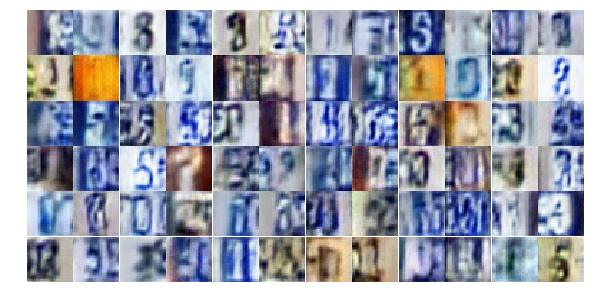

Epoch 5/20... Discriminator Loss: 0.5257... Generator Loss: 1.4610
Epoch 5/20... Discriminator Loss: 1.0444... Generator Loss: 0.5536
Epoch 5/20... Discriminator Loss: 0.6814... Generator Loss: 1.9590
Epoch 5/20... Discriminator Loss: 0.4768... Generator Loss: 1.4534
Epoch 5/20... Discriminator Loss: 0.5378... Generator Loss: 1.3397
Epoch 5/20... Discriminator Loss: 1.5843... Generator Loss: 0.3236
Epoch 6/20... Discriminator Loss: 0.9793... Generator Loss: 0.7810
Epoch 6/20... Discriminator Loss: 0.4929... Generator Loss: 1.3694
Epoch 6/20... Discriminator Loss: 0.5617... Generator Loss: 1.4744
Epoch 6/20... Discriminator Loss: 0.7125... Generator Loss: 0.9598


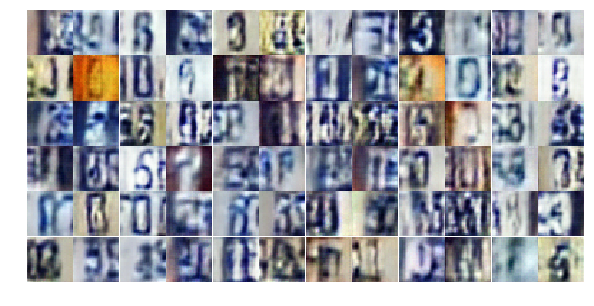

Epoch 6/20... Discriminator Loss: 0.5799... Generator Loss: 1.3107
Epoch 6/20... Discriminator Loss: 0.5881... Generator Loss: 1.2402
Epoch 6/20... Discriminator Loss: 0.5056... Generator Loss: 1.4279
Epoch 6/20... Discriminator Loss: 1.2386... Generator Loss: 0.4940
Epoch 6/20... Discriminator Loss: 0.7193... Generator Loss: 0.9026
Epoch 6/20... Discriminator Loss: 0.4852... Generator Loss: 1.3097
Epoch 6/20... Discriminator Loss: 0.3991... Generator Loss: 1.7916
Epoch 6/20... Discriminator Loss: 0.9525... Generator Loss: 0.6599
Epoch 6/20... Discriminator Loss: 0.5318... Generator Loss: 1.6042
Epoch 6/20... Discriminator Loss: 0.7965... Generator Loss: 2.5994


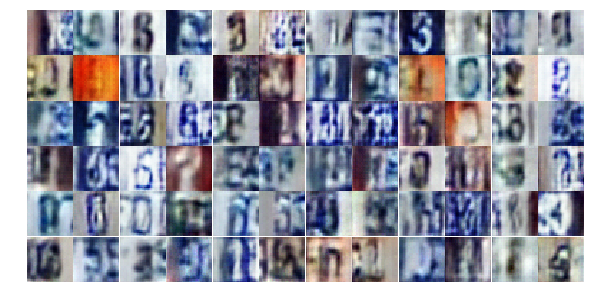

Epoch 6/20... Discriminator Loss: 0.7127... Generator Loss: 1.7189
Epoch 6/20... Discriminator Loss: 0.7022... Generator Loss: 1.8952
Epoch 6/20... Discriminator Loss: 0.7495... Generator Loss: 1.0991
Epoch 6/20... Discriminator Loss: 0.6983... Generator Loss: 1.1542
Epoch 6/20... Discriminator Loss: 0.4252... Generator Loss: 1.8445
Epoch 6/20... Discriminator Loss: 0.5959... Generator Loss: 1.2135
Epoch 6/20... Discriminator Loss: 0.3898... Generator Loss: 1.8279
Epoch 6/20... Discriminator Loss: 0.5725... Generator Loss: 1.2502
Epoch 6/20... Discriminator Loss: 0.7984... Generator Loss: 2.4684
Epoch 6/20... Discriminator Loss: 0.6470... Generator Loss: 1.5211


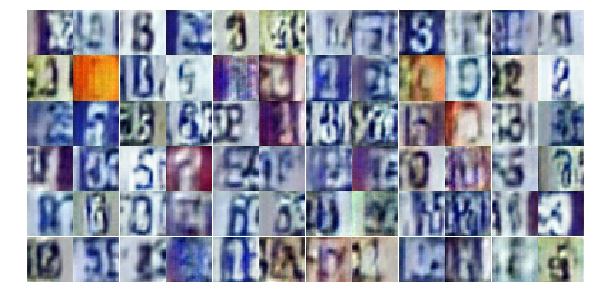

Epoch 6/20... Discriminator Loss: 1.5620... Generator Loss: 0.3387
Epoch 6/20... Discriminator Loss: 0.4979... Generator Loss: 1.5572
Epoch 6/20... Discriminator Loss: 1.0481... Generator Loss: 0.6220
Epoch 6/20... Discriminator Loss: 0.6289... Generator Loss: 1.1403
Epoch 6/20... Discriminator Loss: 0.7680... Generator Loss: 2.9976
Epoch 6/20... Discriminator Loss: 1.5560... Generator Loss: 0.3391
Epoch 6/20... Discriminator Loss: 0.7935... Generator Loss: 0.9526
Epoch 6/20... Discriminator Loss: 0.3500... Generator Loss: 1.8749
Epoch 6/20... Discriminator Loss: 0.6473... Generator Loss: 1.0461
Epoch 6/20... Discriminator Loss: 0.5100... Generator Loss: 1.9890


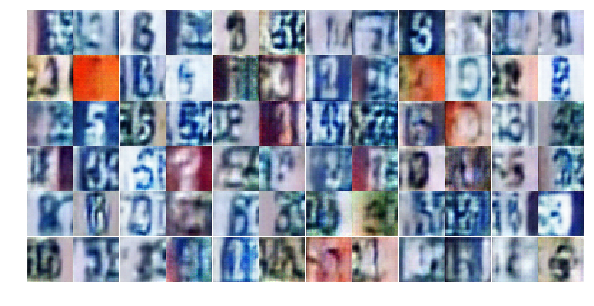

Epoch 6/20... Discriminator Loss: 1.2951... Generator Loss: 0.4900
Epoch 6/20... Discriminator Loss: 0.8593... Generator Loss: 1.4037
Epoch 6/20... Discriminator Loss: 0.8295... Generator Loss: 0.8707
Epoch 6/20... Discriminator Loss: 0.6355... Generator Loss: 1.1017
Epoch 6/20... Discriminator Loss: 0.5432... Generator Loss: 1.2790
Epoch 6/20... Discriminator Loss: 0.6472... Generator Loss: 1.0583
Epoch 6/20... Discriminator Loss: 0.3668... Generator Loss: 1.9654
Epoch 6/20... Discriminator Loss: 0.3592... Generator Loss: 1.9674
Epoch 6/20... Discriminator Loss: 0.8674... Generator Loss: 0.7436
Epoch 6/20... Discriminator Loss: 0.5135... Generator Loss: 1.2335


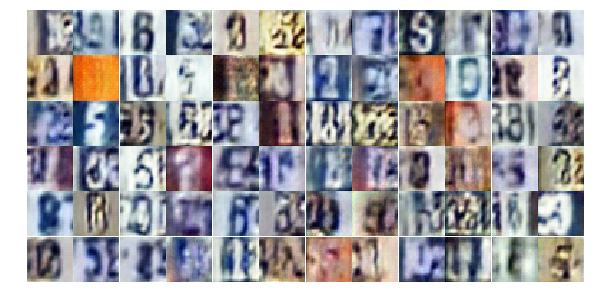

Epoch 6/20... Discriminator Loss: 0.7305... Generator Loss: 1.7492
Epoch 6/20... Discriminator Loss: 0.7691... Generator Loss: 0.9175
Epoch 6/20... Discriminator Loss: 1.0526... Generator Loss: 0.6095
Epoch 6/20... Discriminator Loss: 0.4898... Generator Loss: 2.0208
Epoch 6/20... Discriminator Loss: 0.4218... Generator Loss: 1.4575
Epoch 6/20... Discriminator Loss: 0.5402... Generator Loss: 1.2124
Epoch 6/20... Discriminator Loss: 0.5131... Generator Loss: 1.2587
Epoch 6/20... Discriminator Loss: 2.0714... Generator Loss: 3.2241
Epoch 6/20... Discriminator Loss: 1.1222... Generator Loss: 0.5689
Epoch 6/20... Discriminator Loss: 0.8786... Generator Loss: 0.9387


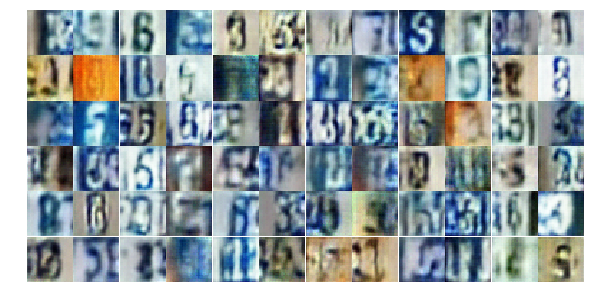

Epoch 6/20... Discriminator Loss: 0.5116... Generator Loss: 1.3770
Epoch 6/20... Discriminator Loss: 0.5981... Generator Loss: 1.0470
Epoch 6/20... Discriminator Loss: 0.6577... Generator Loss: 1.1976
Epoch 7/20... Discriminator Loss: 0.5411... Generator Loss: 2.0667
Epoch 7/20... Discriminator Loss: 0.5552... Generator Loss: 1.2359
Epoch 7/20... Discriminator Loss: 0.3783... Generator Loss: 2.2685
Epoch 7/20... Discriminator Loss: 0.4048... Generator Loss: 1.7929
Epoch 7/20... Discriminator Loss: 0.2860... Generator Loss: 2.0737
Epoch 7/20... Discriminator Loss: 0.8559... Generator Loss: 3.3747
Epoch 7/20... Discriminator Loss: 1.2388... Generator Loss: 0.5232


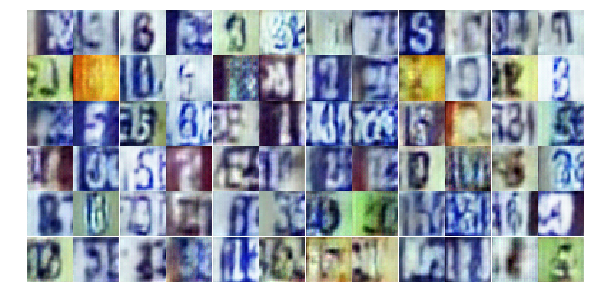

Epoch 7/20... Discriminator Loss: 0.6581... Generator Loss: 1.6967
Epoch 7/20... Discriminator Loss: 0.9962... Generator Loss: 0.6479
Epoch 7/20... Discriminator Loss: 0.6944... Generator Loss: 1.0758
Epoch 7/20... Discriminator Loss: 0.5851... Generator Loss: 1.5238
Epoch 7/20... Discriminator Loss: 0.5073... Generator Loss: 1.3577
Epoch 7/20... Discriminator Loss: 0.4915... Generator Loss: 1.4599
Epoch 7/20... Discriminator Loss: 0.7319... Generator Loss: 3.0237
Epoch 7/20... Discriminator Loss: 1.3570... Generator Loss: 2.7660
Epoch 7/20... Discriminator Loss: 0.5145... Generator Loss: 2.0403
Epoch 7/20... Discriminator Loss: 0.4495... Generator Loss: 1.5353


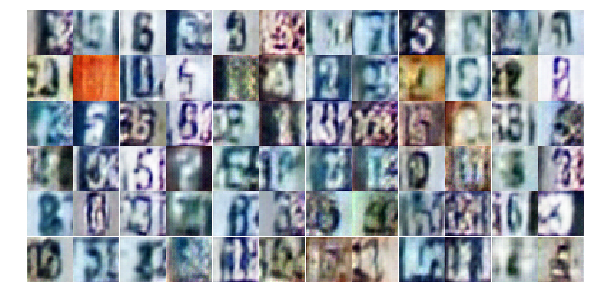

Epoch 7/20... Discriminator Loss: 1.5774... Generator Loss: 0.3449
Epoch 7/20... Discriminator Loss: 0.6689... Generator Loss: 1.2006
Epoch 7/20... Discriminator Loss: 0.8943... Generator Loss: 0.7469
Epoch 7/20... Discriminator Loss: 0.5890... Generator Loss: 1.5512
Epoch 7/20... Discriminator Loss: 0.5033... Generator Loss: 1.2988
Epoch 7/20... Discriminator Loss: 0.4070... Generator Loss: 1.6766
Epoch 7/20... Discriminator Loss: 0.6539... Generator Loss: 0.9742
Epoch 7/20... Discriminator Loss: 1.2147... Generator Loss: 0.5051
Epoch 7/20... Discriminator Loss: 0.4485... Generator Loss: 1.6347
Epoch 7/20... Discriminator Loss: 0.5011... Generator Loss: 2.1648


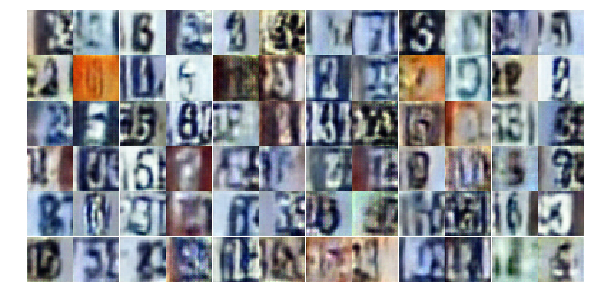

Epoch 7/20... Discriminator Loss: 0.8476... Generator Loss: 0.8509
Epoch 7/20... Discriminator Loss: 0.6857... Generator Loss: 1.0738
Epoch 7/20... Discriminator Loss: 0.4334... Generator Loss: 1.4960
Epoch 7/20... Discriminator Loss: 0.6579... Generator Loss: 1.0036
Epoch 7/20... Discriminator Loss: 0.4697... Generator Loss: 1.6871
Epoch 7/20... Discriminator Loss: 0.7024... Generator Loss: 0.9392
Epoch 7/20... Discriminator Loss: 0.7515... Generator Loss: 0.8422
Epoch 7/20... Discriminator Loss: 0.5199... Generator Loss: 1.3237
Epoch 7/20... Discriminator Loss: 0.8458... Generator Loss: 0.8069
Epoch 7/20... Discriminator Loss: 0.4766... Generator Loss: 3.1813


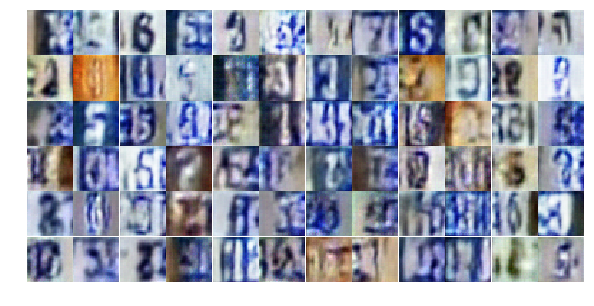

Epoch 7/20... Discriminator Loss: 0.9034... Generator Loss: 0.9018
Epoch 7/20... Discriminator Loss: 1.4540... Generator Loss: 3.5080
Epoch 7/20... Discriminator Loss: 1.0949... Generator Loss: 4.3913
Epoch 7/20... Discriminator Loss: 0.5438... Generator Loss: 1.3543
Epoch 7/20... Discriminator Loss: 0.8010... Generator Loss: 0.8372
Epoch 7/20... Discriminator Loss: 0.4100... Generator Loss: 1.7186
Epoch 7/20... Discriminator Loss: 0.5801... Generator Loss: 1.1221
Epoch 7/20... Discriminator Loss: 2.1095... Generator Loss: 0.2564
Epoch 7/20... Discriminator Loss: 0.5112... Generator Loss: 3.0267
Epoch 7/20... Discriminator Loss: 0.9183... Generator Loss: 0.8890


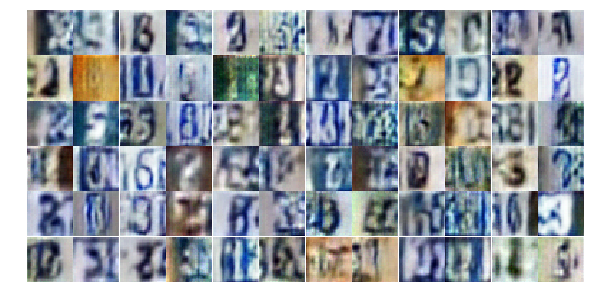

Epoch 7/20... Discriminator Loss: 0.5664... Generator Loss: 3.5254
Epoch 7/20... Discriminator Loss: 0.4866... Generator Loss: 1.4250
Epoch 7/20... Discriminator Loss: 0.6104... Generator Loss: 1.5323
Epoch 7/20... Discriminator Loss: 0.5094... Generator Loss: 1.2715
Epoch 7/20... Discriminator Loss: 0.5687... Generator Loss: 1.3027
Epoch 7/20... Discriminator Loss: 0.5733... Generator Loss: 1.2434
Epoch 7/20... Discriminator Loss: 1.2732... Generator Loss: 0.4345
Epoch 7/20... Discriminator Loss: 0.6982... Generator Loss: 1.6492
Epoch 7/20... Discriminator Loss: 0.7318... Generator Loss: 2.2954
Epoch 7/20... Discriminator Loss: 0.6748... Generator Loss: 1.0259


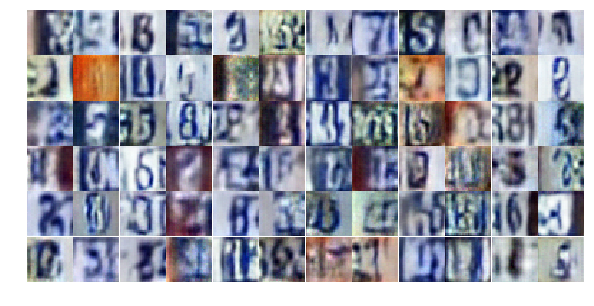

Epoch 7/20... Discriminator Loss: 0.3752... Generator Loss: 1.5240
Epoch 8/20... Discriminator Loss: 0.4933... Generator Loss: 1.2898
Epoch 8/20... Discriminator Loss: 0.6629... Generator Loss: 0.9578
Epoch 8/20... Discriminator Loss: 0.5371... Generator Loss: 1.3002
Epoch 8/20... Discriminator Loss: 0.4902... Generator Loss: 1.6851
Epoch 8/20... Discriminator Loss: 0.8251... Generator Loss: 2.8312
Epoch 8/20... Discriminator Loss: 1.3193... Generator Loss: 0.4391
Epoch 8/20... Discriminator Loss: 0.4292... Generator Loss: 2.3610
Epoch 8/20... Discriminator Loss: 0.9940... Generator Loss: 0.7729
Epoch 8/20... Discriminator Loss: 0.5187... Generator Loss: 1.3522


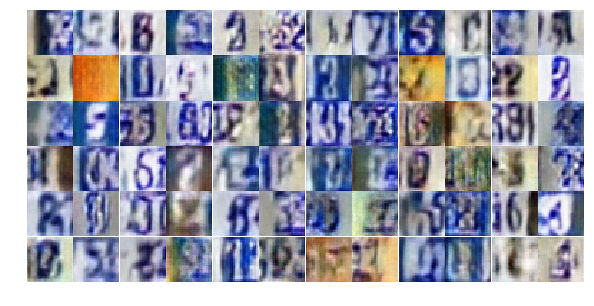

Epoch 8/20... Discriminator Loss: 0.6664... Generator Loss: 1.1475
Epoch 8/20... Discriminator Loss: 0.4639... Generator Loss: 2.2613
Epoch 8/20... Discriminator Loss: 0.8236... Generator Loss: 0.8770
Epoch 8/20... Discriminator Loss: 0.3456... Generator Loss: 1.8549
Epoch 8/20... Discriminator Loss: 1.2352... Generator Loss: 0.4647
Epoch 8/20... Discriminator Loss: 0.5455... Generator Loss: 1.7511
Epoch 8/20... Discriminator Loss: 0.3213... Generator Loss: 2.0455
Epoch 8/20... Discriminator Loss: 0.5062... Generator Loss: 1.6481
Epoch 8/20... Discriminator Loss: 0.6878... Generator Loss: 1.1247
Epoch 8/20... Discriminator Loss: 1.0667... Generator Loss: 0.6170


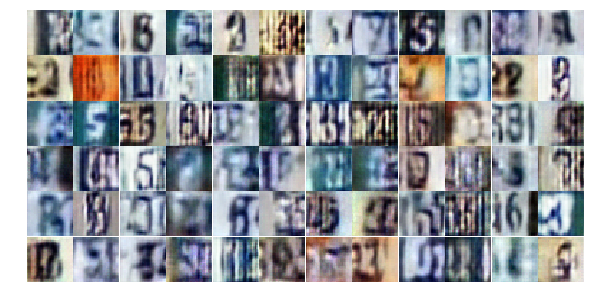

Epoch 8/20... Discriminator Loss: 0.6392... Generator Loss: 1.3039
Epoch 8/20... Discriminator Loss: 0.4915... Generator Loss: 1.2702
Epoch 8/20... Discriminator Loss: 0.6441... Generator Loss: 1.5788
Epoch 8/20... Discriminator Loss: 0.6174... Generator Loss: 1.6959
Epoch 8/20... Discriminator Loss: 0.5057... Generator Loss: 2.6655
Epoch 8/20... Discriminator Loss: 0.5504... Generator Loss: 1.2454
Epoch 8/20... Discriminator Loss: 0.4952... Generator Loss: 1.3911
Epoch 8/20... Discriminator Loss: 0.6219... Generator Loss: 1.4536
Epoch 8/20... Discriminator Loss: 0.9416... Generator Loss: 2.0677
Epoch 8/20... Discriminator Loss: 0.7845... Generator Loss: 0.9544


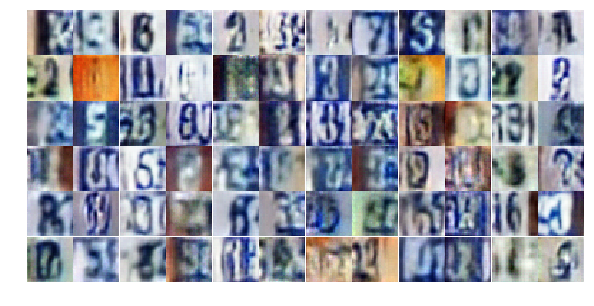

Epoch 8/20... Discriminator Loss: 0.7700... Generator Loss: 0.8434
Epoch 8/20... Discriminator Loss: 0.9774... Generator Loss: 0.6783
Epoch 8/20... Discriminator Loss: 0.4849... Generator Loss: 1.3606
Epoch 8/20... Discriminator Loss: 0.5713... Generator Loss: 1.2067
Epoch 8/20... Discriminator Loss: 1.0594... Generator Loss: 0.5994
Epoch 8/20... Discriminator Loss: 0.5270... Generator Loss: 1.2766
Epoch 8/20... Discriminator Loss: 0.6514... Generator Loss: 1.2346
Epoch 8/20... Discriminator Loss: 0.4324... Generator Loss: 1.5154
Epoch 8/20... Discriminator Loss: 0.5365... Generator Loss: 1.3116
Epoch 8/20... Discriminator Loss: 0.4485... Generator Loss: 1.4489


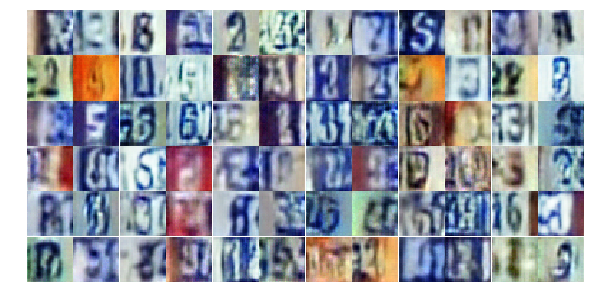

Epoch 8/20... Discriminator Loss: 0.5655... Generator Loss: 2.1608
Epoch 8/20... Discriminator Loss: 1.5185... Generator Loss: 0.3871
Epoch 8/20... Discriminator Loss: 0.8096... Generator Loss: 0.7962
Epoch 8/20... Discriminator Loss: 0.7911... Generator Loss: 0.8949
Epoch 8/20... Discriminator Loss: 1.3297... Generator Loss: 2.9672
Epoch 8/20... Discriminator Loss: 0.5984... Generator Loss: 1.1614
Epoch 8/20... Discriminator Loss: 0.4920... Generator Loss: 1.6657
Epoch 8/20... Discriminator Loss: 0.5664... Generator Loss: 1.2419
Epoch 8/20... Discriminator Loss: 0.4880... Generator Loss: 1.3424
Epoch 8/20... Discriminator Loss: 0.5652... Generator Loss: 1.9523


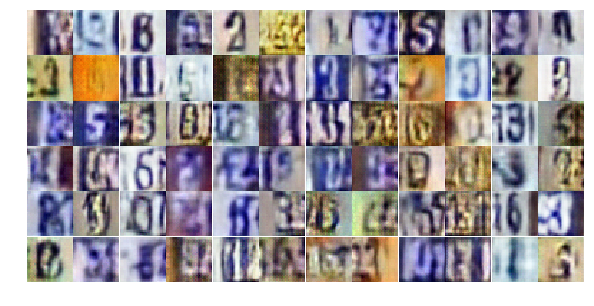

Epoch 8/20... Discriminator Loss: 0.4858... Generator Loss: 1.4027
Epoch 8/20... Discriminator Loss: 0.6493... Generator Loss: 0.9867
Epoch 8/20... Discriminator Loss: 0.3879... Generator Loss: 1.9894
Epoch 8/20... Discriminator Loss: 0.6518... Generator Loss: 0.9549
Epoch 8/20... Discriminator Loss: 0.3671... Generator Loss: 3.3370
Epoch 8/20... Discriminator Loss: 1.0822... Generator Loss: 2.5571
Epoch 8/20... Discriminator Loss: 0.6234... Generator Loss: 1.1369
Epoch 8/20... Discriminator Loss: 0.6162... Generator Loss: 1.5376
Epoch 9/20... Discriminator Loss: 0.6434... Generator Loss: 1.3826
Epoch 9/20... Discriminator Loss: 0.5027... Generator Loss: 1.4535


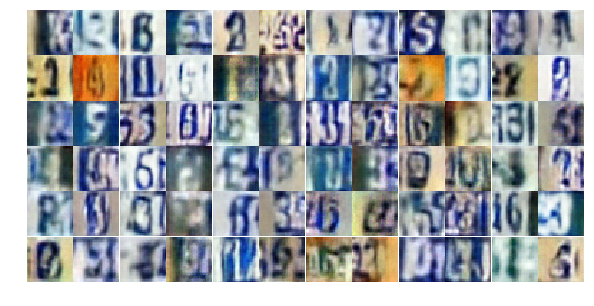

Epoch 9/20... Discriminator Loss: 0.7118... Generator Loss: 0.9001
Epoch 9/20... Discriminator Loss: 0.7609... Generator Loss: 0.8942
Epoch 9/20... Discriminator Loss: 1.1149... Generator Loss: 0.5355
Epoch 9/20... Discriminator Loss: 0.5759... Generator Loss: 1.9096
Epoch 9/20... Discriminator Loss: 1.4700... Generator Loss: 0.3464
Epoch 9/20... Discriminator Loss: 0.6539... Generator Loss: 3.5290
Epoch 9/20... Discriminator Loss: 0.8279... Generator Loss: 1.0715
Epoch 9/20... Discriminator Loss: 0.4603... Generator Loss: 1.4281
Epoch 9/20... Discriminator Loss: 0.8151... Generator Loss: 0.7991
Epoch 9/20... Discriminator Loss: 0.6519... Generator Loss: 1.1304


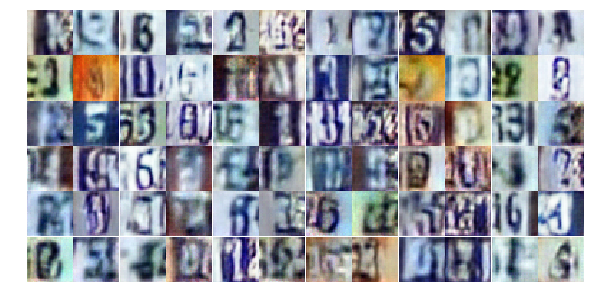

Epoch 9/20... Discriminator Loss: 0.8219... Generator Loss: 0.8720
Epoch 9/20... Discriminator Loss: 1.2342... Generator Loss: 0.4775
Epoch 9/20... Discriminator Loss: 0.7524... Generator Loss: 1.7574
Epoch 9/20... Discriminator Loss: 0.9925... Generator Loss: 1.2240
Epoch 9/20... Discriminator Loss: 0.5285... Generator Loss: 1.4056
Epoch 9/20... Discriminator Loss: 0.8160... Generator Loss: 0.8568
Epoch 9/20... Discriminator Loss: 0.8229... Generator Loss: 0.8644
Epoch 9/20... Discriminator Loss: 0.7224... Generator Loss: 0.9671
Epoch 9/20... Discriminator Loss: 1.1357... Generator Loss: 0.5462
Epoch 9/20... Discriminator Loss: 0.9422... Generator Loss: 0.6568


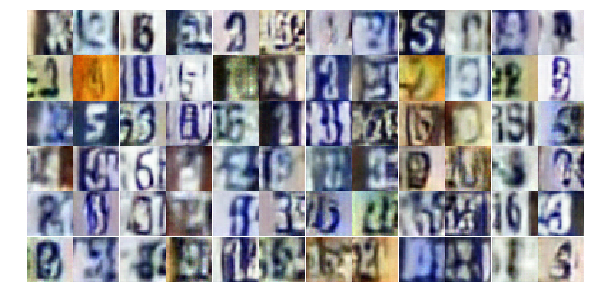

Epoch 9/20... Discriminator Loss: 0.8821... Generator Loss: 0.7852
Epoch 9/20... Discriminator Loss: 0.5777... Generator Loss: 1.3214
Epoch 9/20... Discriminator Loss: 0.6412... Generator Loss: 1.9882
Epoch 9/20... Discriminator Loss: 0.7916... Generator Loss: 0.9212
Epoch 9/20... Discriminator Loss: 0.5328... Generator Loss: 1.4549
Epoch 9/20... Discriminator Loss: 0.6293... Generator Loss: 1.5675
Epoch 9/20... Discriminator Loss: 0.9948... Generator Loss: 0.6041
Epoch 9/20... Discriminator Loss: 0.5278... Generator Loss: 2.0078
Epoch 9/20... Discriminator Loss: 0.5574... Generator Loss: 1.2297
Epoch 9/20... Discriminator Loss: 0.6133... Generator Loss: 1.0721


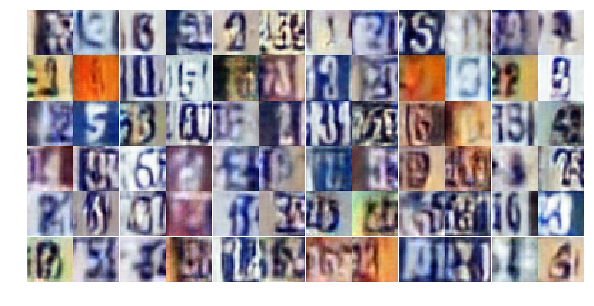

Epoch 9/20... Discriminator Loss: 0.7840... Generator Loss: 0.8369
Epoch 9/20... Discriminator Loss: 0.4867... Generator Loss: 1.3284
Epoch 9/20... Discriminator Loss: 0.6843... Generator Loss: 1.2158
Epoch 9/20... Discriminator Loss: 0.5836... Generator Loss: 1.3616
Epoch 9/20... Discriminator Loss: 0.4966... Generator Loss: 1.4715
Epoch 9/20... Discriminator Loss: 0.6724... Generator Loss: 0.9838
Epoch 9/20... Discriminator Loss: 0.6373... Generator Loss: 2.1454
Epoch 9/20... Discriminator Loss: 0.4505... Generator Loss: 1.4241
Epoch 9/20... Discriminator Loss: 0.7707... Generator Loss: 0.8907
Epoch 9/20... Discriminator Loss: 0.6060... Generator Loss: 1.1106


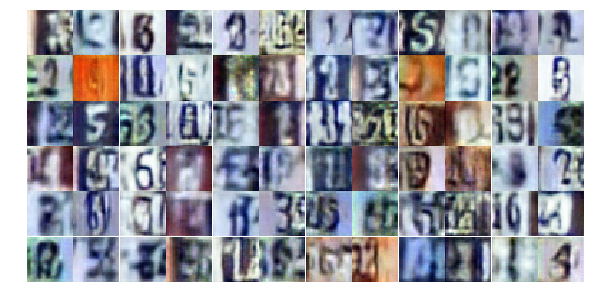

Epoch 9/20... Discriminator Loss: 0.5547... Generator Loss: 1.2418
Epoch 9/20... Discriminator Loss: 0.6909... Generator Loss: 1.0257
Epoch 9/20... Discriminator Loss: 1.2830... Generator Loss: 3.6006
Epoch 9/20... Discriminator Loss: 0.7018... Generator Loss: 1.0944
Epoch 9/20... Discriminator Loss: 0.5059... Generator Loss: 1.3706
Epoch 9/20... Discriminator Loss: 0.9091... Generator Loss: 0.7338
Epoch 9/20... Discriminator Loss: 0.6845... Generator Loss: 1.7017
Epoch 9/20... Discriminator Loss: 0.9765... Generator Loss: 0.5898
Epoch 9/20... Discriminator Loss: 0.6498... Generator Loss: 1.0689
Epoch 9/20... Discriminator Loss: 0.5255... Generator Loss: 2.5823


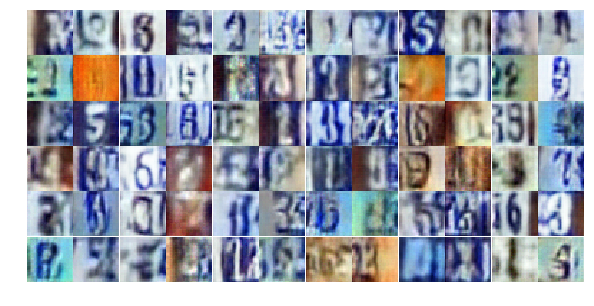

Epoch 9/20... Discriminator Loss: 0.7451... Generator Loss: 0.9427
Epoch 9/20... Discriminator Loss: 0.6328... Generator Loss: 1.5814
Epoch 9/20... Discriminator Loss: 0.9052... Generator Loss: 0.8008
Epoch 9/20... Discriminator Loss: 1.2377... Generator Loss: 0.4475
Epoch 9/20... Discriminator Loss: 0.8250... Generator Loss: 0.8803
Epoch 10/20... Discriminator Loss: 0.5769... Generator Loss: 1.4042
Epoch 10/20... Discriminator Loss: 0.5085... Generator Loss: 1.5382
Epoch 10/20... Discriminator Loss: 0.7711... Generator Loss: 0.8518
Epoch 10/20... Discriminator Loss: 0.5912... Generator Loss: 1.5049
Epoch 10/20... Discriminator Loss: 0.8955... Generator Loss: 0.7052


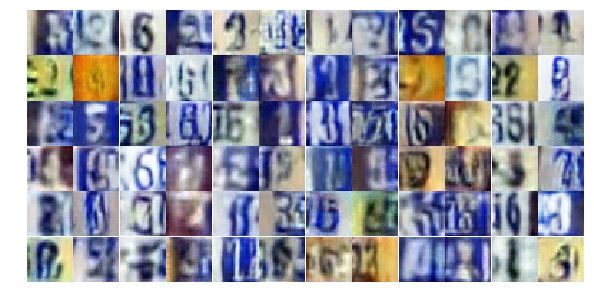

Epoch 10/20... Discriminator Loss: 0.6169... Generator Loss: 1.4247
Epoch 10/20... Discriminator Loss: 0.4327... Generator Loss: 1.9625
Epoch 10/20... Discriminator Loss: 0.7425... Generator Loss: 1.0712
Epoch 10/20... Discriminator Loss: 0.6713... Generator Loss: 1.1188
Epoch 10/20... Discriminator Loss: 0.7089... Generator Loss: 1.0875
Epoch 10/20... Discriminator Loss: 0.7875... Generator Loss: 0.9322
Epoch 10/20... Discriminator Loss: 0.6630... Generator Loss: 0.9921
Epoch 10/20... Discriminator Loss: 0.7711... Generator Loss: 0.7819
Epoch 10/20... Discriminator Loss: 0.6527... Generator Loss: 1.5357
Epoch 10/20... Discriminator Loss: 0.5917... Generator Loss: 1.6058


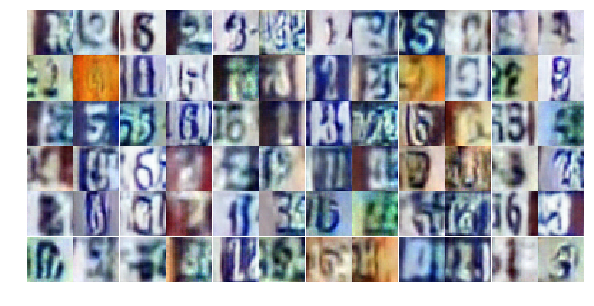

Epoch 10/20... Discriminator Loss: 0.6534... Generator Loss: 1.2791
Epoch 10/20... Discriminator Loss: 1.1386... Generator Loss: 0.6151
Epoch 10/20... Discriminator Loss: 0.5638... Generator Loss: 1.4503
Epoch 10/20... Discriminator Loss: 1.0242... Generator Loss: 0.6044
Epoch 10/20... Discriminator Loss: 0.6615... Generator Loss: 1.2459
Epoch 10/20... Discriminator Loss: 0.5066... Generator Loss: 1.3285
Epoch 10/20... Discriminator Loss: 0.6978... Generator Loss: 0.9570
Epoch 10/20... Discriminator Loss: 0.5095... Generator Loss: 1.4912
Epoch 10/20... Discriminator Loss: 0.6194... Generator Loss: 1.2613
Epoch 10/20... Discriminator Loss: 0.7076... Generator Loss: 2.8690


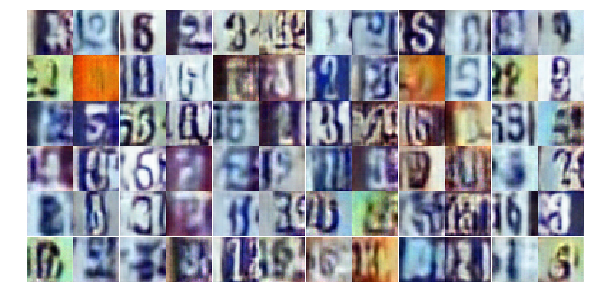

Epoch 10/20... Discriminator Loss: 1.0535... Generator Loss: 0.5706
Epoch 10/20... Discriminator Loss: 0.5902... Generator Loss: 1.1358
Epoch 10/20... Discriminator Loss: 0.4942... Generator Loss: 1.3662
Epoch 10/20... Discriminator Loss: 0.3232... Generator Loss: 2.1688
Epoch 10/20... Discriminator Loss: 1.2746... Generator Loss: 0.4243
Epoch 10/20... Discriminator Loss: 0.7808... Generator Loss: 0.8468
Epoch 10/20... Discriminator Loss: 0.3764... Generator Loss: 1.6763
Epoch 10/20... Discriminator Loss: 0.6486... Generator Loss: 1.2485
Epoch 10/20... Discriminator Loss: 0.7109... Generator Loss: 0.8792
Epoch 10/20... Discriminator Loss: 0.5545... Generator Loss: 1.5190


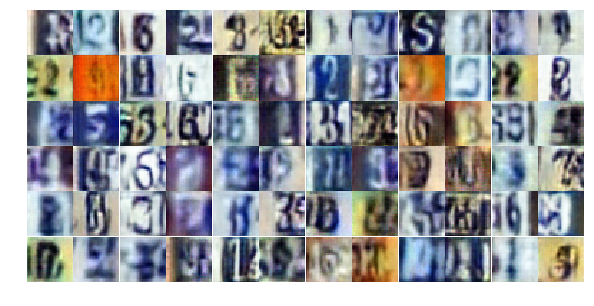

Epoch 10/20... Discriminator Loss: 1.0559... Generator Loss: 3.1177
Epoch 10/20... Discriminator Loss: 0.6598... Generator Loss: 1.1876
Epoch 10/20... Discriminator Loss: 0.6504... Generator Loss: 1.9664
Epoch 10/20... Discriminator Loss: 0.5189... Generator Loss: 1.8801
Epoch 10/20... Discriminator Loss: 0.6491... Generator Loss: 1.0958
Epoch 10/20... Discriminator Loss: 0.5432... Generator Loss: 2.1711
Epoch 10/20... Discriminator Loss: 0.5692... Generator Loss: 1.2392
Epoch 10/20... Discriminator Loss: 0.7544... Generator Loss: 0.9037
Epoch 10/20... Discriminator Loss: 1.0221... Generator Loss: 0.6031
Epoch 10/20... Discriminator Loss: 0.6459... Generator Loss: 1.7852


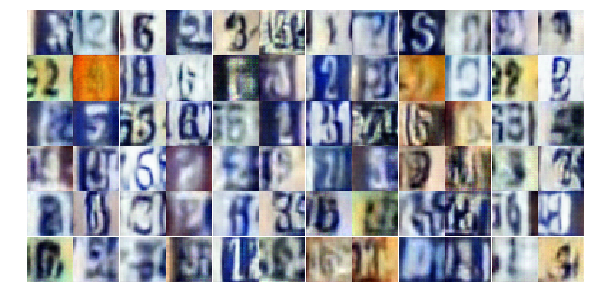

Epoch 10/20... Discriminator Loss: 0.6759... Generator Loss: 1.0894
Epoch 10/20... Discriminator Loss: 0.8412... Generator Loss: 0.8818
Epoch 10/20... Discriminator Loss: 0.7438... Generator Loss: 1.0470
Epoch 10/20... Discriminator Loss: 0.7159... Generator Loss: 0.9609
Epoch 10/20... Discriminator Loss: 0.5652... Generator Loss: 1.2461
Epoch 10/20... Discriminator Loss: 0.6059... Generator Loss: 1.2328
Epoch 10/20... Discriminator Loss: 0.6920... Generator Loss: 0.9619
Epoch 10/20... Discriminator Loss: 0.5879... Generator Loss: 1.1753
Epoch 10/20... Discriminator Loss: 0.5509... Generator Loss: 1.8556
Epoch 10/20... Discriminator Loss: 0.5537... Generator Loss: 1.4754


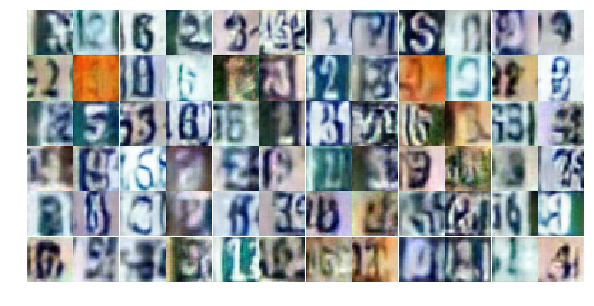

Epoch 10/20... Discriminator Loss: 0.8946... Generator Loss: 1.9089
Epoch 10/20... Discriminator Loss: 0.5451... Generator Loss: 1.2452
Epoch 10/20... Discriminator Loss: 0.5168... Generator Loss: 1.6462
Epoch 11/20... Discriminator Loss: 0.9034... Generator Loss: 0.7165
Epoch 11/20... Discriminator Loss: 0.7267... Generator Loss: 0.8811
Epoch 11/20... Discriminator Loss: 1.1485... Generator Loss: 0.5146
Epoch 11/20... Discriminator Loss: 0.6787... Generator Loss: 0.9605
Epoch 11/20... Discriminator Loss: 0.5758... Generator Loss: 1.3769
Epoch 11/20... Discriminator Loss: 1.8302... Generator Loss: 0.2401
Epoch 11/20... Discriminator Loss: 0.7124... Generator Loss: 1.1008


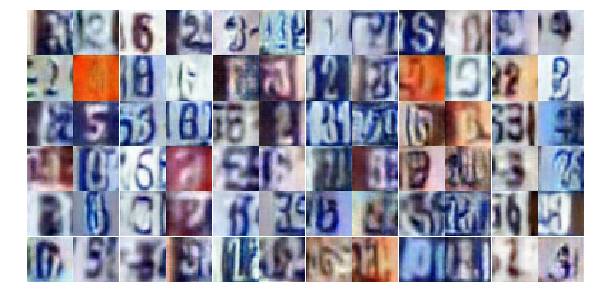

Epoch 11/20... Discriminator Loss: 0.3729... Generator Loss: 1.5626
Epoch 11/20... Discriminator Loss: 0.7392... Generator Loss: 0.9671
Epoch 11/20... Discriminator Loss: 0.6760... Generator Loss: 1.0940
Epoch 11/20... Discriminator Loss: 0.5776... Generator Loss: 1.2681
Epoch 11/20... Discriminator Loss: 0.7175... Generator Loss: 1.1738
Epoch 11/20... Discriminator Loss: 0.4133... Generator Loss: 1.7564
Epoch 11/20... Discriminator Loss: 0.6136... Generator Loss: 1.3031
Epoch 11/20... Discriminator Loss: 0.3167... Generator Loss: 2.1285
Epoch 11/20... Discriminator Loss: 0.7906... Generator Loss: 0.8774
Epoch 11/20... Discriminator Loss: 1.1810... Generator Loss: 0.5220


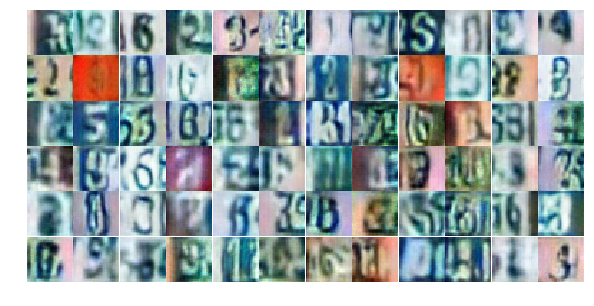

Epoch 11/20... Discriminator Loss: 0.9173... Generator Loss: 0.6987
Epoch 11/20... Discriminator Loss: 0.5196... Generator Loss: 2.0132
Epoch 11/20... Discriminator Loss: 0.9030... Generator Loss: 0.7170
Epoch 11/20... Discriminator Loss: 0.9636... Generator Loss: 0.6527
Epoch 11/20... Discriminator Loss: 0.3611... Generator Loss: 2.0722
Epoch 11/20... Discriminator Loss: 0.5531... Generator Loss: 1.5715
Epoch 11/20... Discriminator Loss: 0.8744... Generator Loss: 0.8687
Epoch 11/20... Discriminator Loss: 1.0222... Generator Loss: 0.7487
Epoch 11/20... Discriminator Loss: 0.4151... Generator Loss: 1.7117
Epoch 11/20... Discriminator Loss: 0.8373... Generator Loss: 0.7502


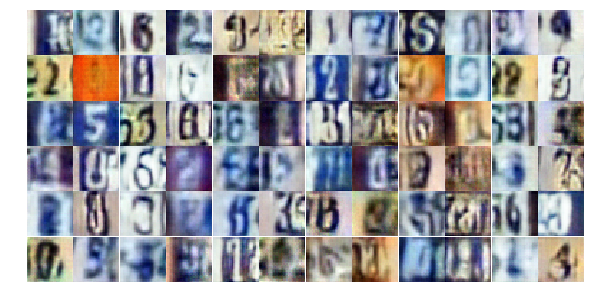

Epoch 11/20... Discriminator Loss: 0.9264... Generator Loss: 0.7211
Epoch 11/20... Discriminator Loss: 0.7109... Generator Loss: 0.9051
Epoch 11/20... Discriminator Loss: 0.8726... Generator Loss: 0.7898
Epoch 11/20... Discriminator Loss: 0.4765... Generator Loss: 1.4272
Epoch 11/20... Discriminator Loss: 0.8276... Generator Loss: 0.8490
Epoch 11/20... Discriminator Loss: 1.5295... Generator Loss: 0.3512
Epoch 11/20... Discriminator Loss: 0.8797... Generator Loss: 1.7542
Epoch 11/20... Discriminator Loss: 0.8113... Generator Loss: 0.8431
Epoch 11/20... Discriminator Loss: 0.7038... Generator Loss: 0.9900
Epoch 11/20... Discriminator Loss: 0.8049... Generator Loss: 0.9875


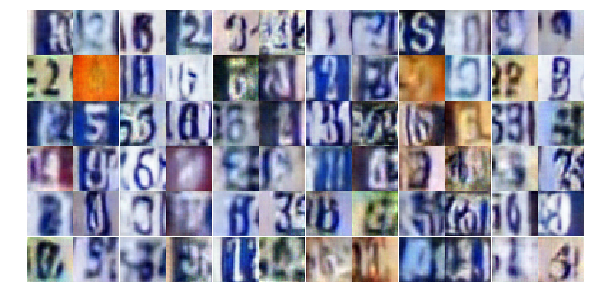

Epoch 11/20... Discriminator Loss: 0.4855... Generator Loss: 1.5301
Epoch 11/20... Discriminator Loss: 0.5551... Generator Loss: 1.3026
Epoch 11/20... Discriminator Loss: 0.7316... Generator Loss: 1.0203
Epoch 11/20... Discriminator Loss: 0.6015... Generator Loss: 1.4682
Epoch 11/20... Discriminator Loss: 0.8965... Generator Loss: 0.6899
Epoch 11/20... Discriminator Loss: 0.5227... Generator Loss: 1.3399
Epoch 11/20... Discriminator Loss: 0.4013... Generator Loss: 2.6580
Epoch 11/20... Discriminator Loss: 0.5286... Generator Loss: 1.3314
Epoch 11/20... Discriminator Loss: 1.1250... Generator Loss: 1.5852
Epoch 11/20... Discriminator Loss: 0.5082... Generator Loss: 1.4191


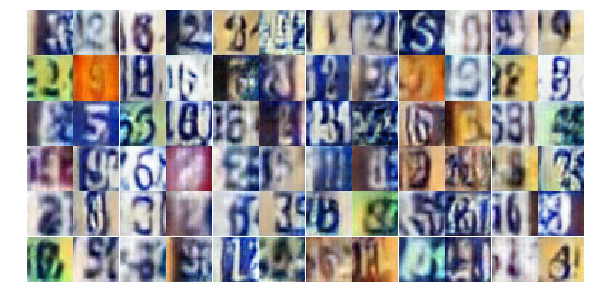

Epoch 11/20... Discriminator Loss: 0.9493... Generator Loss: 0.6617
Epoch 11/20... Discriminator Loss: 0.3791... Generator Loss: 1.8086
Epoch 11/20... Discriminator Loss: 0.6319... Generator Loss: 1.2420
Epoch 11/20... Discriminator Loss: 0.7225... Generator Loss: 0.8318
Epoch 11/20... Discriminator Loss: 1.2962... Generator Loss: 0.4475
Epoch 11/20... Discriminator Loss: 0.8933... Generator Loss: 0.7623
Epoch 11/20... Discriminator Loss: 1.0776... Generator Loss: 0.6995
Epoch 11/20... Discriminator Loss: 0.7118... Generator Loss: 1.7594
Epoch 11/20... Discriminator Loss: 0.8949... Generator Loss: 0.8442
Epoch 11/20... Discriminator Loss: 0.9049... Generator Loss: 0.7928


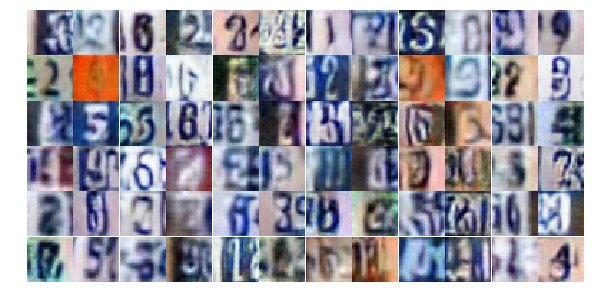

Epoch 12/20... Discriminator Loss: 1.1005... Generator Loss: 0.6052
Epoch 12/20... Discriminator Loss: 0.6327... Generator Loss: 1.1382
Epoch 12/20... Discriminator Loss: 0.9258... Generator Loss: 0.6868
Epoch 12/20... Discriminator Loss: 0.5462... Generator Loss: 1.5564
Epoch 12/20... Discriminator Loss: 0.5467... Generator Loss: 1.2295
Epoch 12/20... Discriminator Loss: 0.8002... Generator Loss: 0.8760
Epoch 12/20... Discriminator Loss: 0.4685... Generator Loss: 1.3713
Epoch 12/20... Discriminator Loss: 0.3696... Generator Loss: 1.8940
Epoch 12/20... Discriminator Loss: 0.4776... Generator Loss: 1.8008
Epoch 12/20... Discriminator Loss: 1.2782... Generator Loss: 0.4544


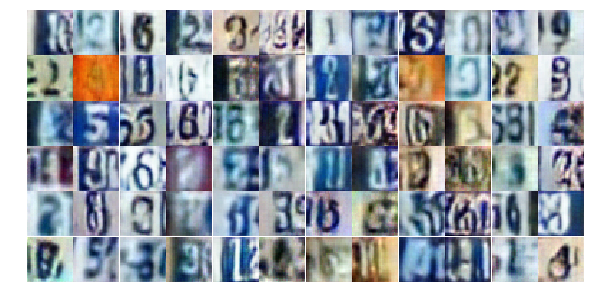

Epoch 12/20... Discriminator Loss: 0.4185... Generator Loss: 1.9380
Epoch 12/20... Discriminator Loss: 0.8127... Generator Loss: 0.9640
Epoch 12/20... Discriminator Loss: 0.7772... Generator Loss: 2.1874
Epoch 12/20... Discriminator Loss: 1.3079... Generator Loss: 3.1805
Epoch 12/20... Discriminator Loss: 0.9704... Generator Loss: 1.4729
Epoch 12/20... Discriminator Loss: 1.6469... Generator Loss: 0.3701
Epoch 12/20... Discriminator Loss: 1.3569... Generator Loss: 0.4171
Epoch 12/20... Discriminator Loss: 0.5371... Generator Loss: 1.8166
Epoch 12/20... Discriminator Loss: 0.5889... Generator Loss: 1.1368
Epoch 12/20... Discriminator Loss: 0.9248... Generator Loss: 0.7333


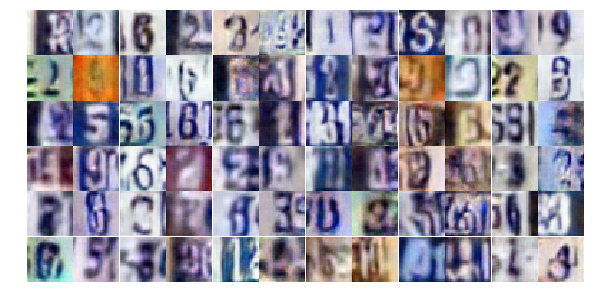

Epoch 12/20... Discriminator Loss: 0.3711... Generator Loss: 1.6128
Epoch 12/20... Discriminator Loss: 0.4046... Generator Loss: 1.7806
Epoch 12/20... Discriminator Loss: 0.8379... Generator Loss: 0.7985
Epoch 12/20... Discriminator Loss: 0.5085... Generator Loss: 1.5036
Epoch 12/20... Discriminator Loss: 0.4021... Generator Loss: 2.0314
Epoch 12/20... Discriminator Loss: 0.6163... Generator Loss: 1.0596
Epoch 12/20... Discriminator Loss: 0.5516... Generator Loss: 1.2318
Epoch 12/20... Discriminator Loss: 0.4096... Generator Loss: 1.5081
Epoch 12/20... Discriminator Loss: 0.5548... Generator Loss: 1.1841
Epoch 12/20... Discriminator Loss: 0.8507... Generator Loss: 0.7332


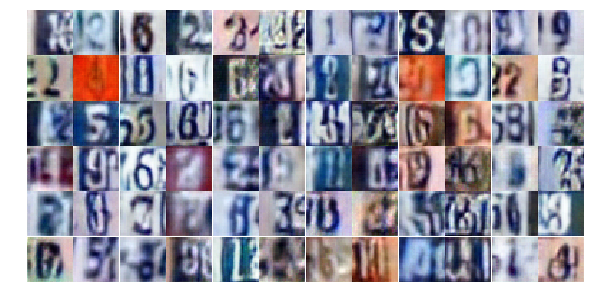

Epoch 12/20... Discriminator Loss: 0.7941... Generator Loss: 0.8489
Epoch 12/20... Discriminator Loss: 0.8630... Generator Loss: 0.7335
Epoch 12/20... Discriminator Loss: 0.7009... Generator Loss: 0.8990
Epoch 12/20... Discriminator Loss: 1.3453... Generator Loss: 0.4253
Epoch 12/20... Discriminator Loss: 0.5159... Generator Loss: 1.7007
Epoch 12/20... Discriminator Loss: 1.1931... Generator Loss: 0.5349
Epoch 12/20... Discriminator Loss: 0.6769... Generator Loss: 0.9874
Epoch 12/20... Discriminator Loss: 0.7540... Generator Loss: 0.9698
Epoch 12/20... Discriminator Loss: 0.5069... Generator Loss: 1.4296
Epoch 12/20... Discriminator Loss: 0.3809... Generator Loss: 2.0470


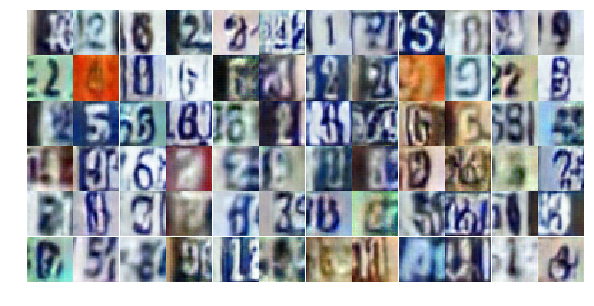

Epoch 12/20... Discriminator Loss: 0.4508... Generator Loss: 1.6358
Epoch 12/20... Discriminator Loss: 0.5233... Generator Loss: 1.1604
Epoch 12/20... Discriminator Loss: 0.5030... Generator Loss: 1.2648
Epoch 12/20... Discriminator Loss: 0.6971... Generator Loss: 0.9743
Epoch 12/20... Discriminator Loss: 0.7661... Generator Loss: 0.9179
Epoch 12/20... Discriminator Loss: 0.7767... Generator Loss: 0.8840
Epoch 12/20... Discriminator Loss: 0.6086... Generator Loss: 1.1680
Epoch 12/20... Discriminator Loss: 0.6066... Generator Loss: 1.3813
Epoch 12/20... Discriminator Loss: 0.5670... Generator Loss: 1.2623
Epoch 12/20... Discriminator Loss: 0.6325... Generator Loss: 1.1129


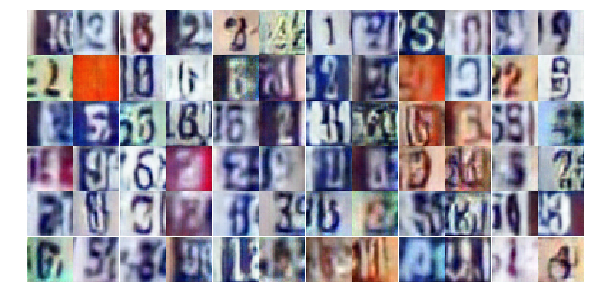

Epoch 12/20... Discriminator Loss: 0.8645... Generator Loss: 0.8320
Epoch 12/20... Discriminator Loss: 1.4611... Generator Loss: 0.3671
Epoch 12/20... Discriminator Loss: 0.8477... Generator Loss: 0.8450
Epoch 12/20... Discriminator Loss: 1.2223... Generator Loss: 0.6137
Epoch 12/20... Discriminator Loss: 0.4521... Generator Loss: 1.4714
Epoch 12/20... Discriminator Loss: 0.6538... Generator Loss: 1.8108
Epoch 12/20... Discriminator Loss: 0.7712... Generator Loss: 0.9570
Epoch 13/20... Discriminator Loss: 0.4645... Generator Loss: 1.3337
Epoch 13/20... Discriminator Loss: 0.4552... Generator Loss: 1.6059
Epoch 13/20... Discriminator Loss: 0.7364... Generator Loss: 1.2918


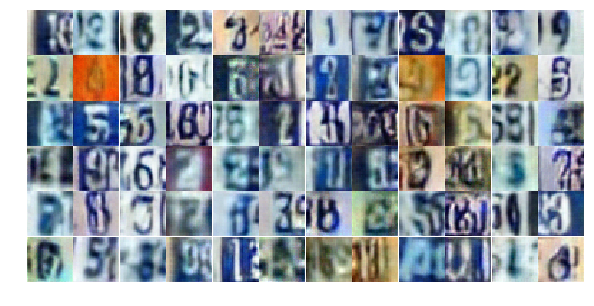

Epoch 13/20... Discriminator Loss: 0.5394... Generator Loss: 1.2845
Epoch 13/20... Discriminator Loss: 0.5441... Generator Loss: 2.1422
Epoch 13/20... Discriminator Loss: 1.0155... Generator Loss: 0.6887
Epoch 13/20... Discriminator Loss: 1.0226... Generator Loss: 0.6118
Epoch 13/20... Discriminator Loss: 0.6806... Generator Loss: 1.0673
Epoch 13/20... Discriminator Loss: 0.5673... Generator Loss: 1.2568
Epoch 13/20... Discriminator Loss: 0.3992... Generator Loss: 1.8482
Epoch 13/20... Discriminator Loss: 1.0348... Generator Loss: 0.5403
Epoch 13/20... Discriminator Loss: 0.6863... Generator Loss: 0.9951
Epoch 13/20... Discriminator Loss: 0.5932... Generator Loss: 3.4259


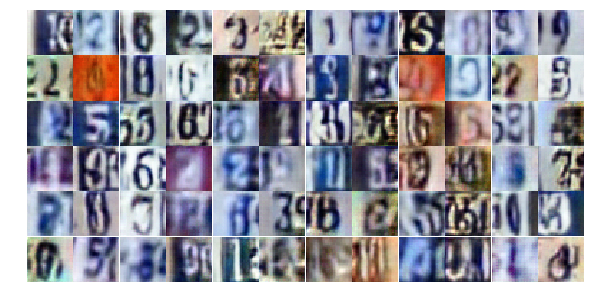

Epoch 13/20... Discriminator Loss: 2.3372... Generator Loss: 4.7680
Epoch 13/20... Discriminator Loss: 0.7437... Generator Loss: 0.9363
Epoch 13/20... Discriminator Loss: 0.9068... Generator Loss: 0.7431
Epoch 13/20... Discriminator Loss: 0.7993... Generator Loss: 0.8900
Epoch 13/20... Discriminator Loss: 0.6547... Generator Loss: 1.3033
Epoch 13/20... Discriminator Loss: 0.8580... Generator Loss: 0.9524
Epoch 13/20... Discriminator Loss: 0.7553... Generator Loss: 1.0037
Epoch 13/20... Discriminator Loss: 1.0300... Generator Loss: 0.6374
Epoch 13/20... Discriminator Loss: 0.6651... Generator Loss: 1.1386
Epoch 13/20... Discriminator Loss: 1.0368... Generator Loss: 0.6210


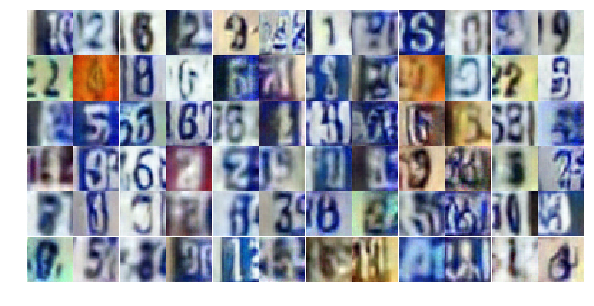

Epoch 13/20... Discriminator Loss: 0.6859... Generator Loss: 0.9589
Epoch 13/20... Discriminator Loss: 0.6903... Generator Loss: 2.3570
Epoch 13/20... Discriminator Loss: 0.5504... Generator Loss: 1.3458
Epoch 13/20... Discriminator Loss: 0.6385... Generator Loss: 1.5851
Epoch 13/20... Discriminator Loss: 0.5451... Generator Loss: 1.1962
Epoch 13/20... Discriminator Loss: 0.8804... Generator Loss: 0.7513
Epoch 13/20... Discriminator Loss: 0.7661... Generator Loss: 1.6847
Epoch 13/20... Discriminator Loss: 0.5010... Generator Loss: 1.4118
Epoch 13/20... Discriminator Loss: 0.5207... Generator Loss: 1.2475
Epoch 13/20... Discriminator Loss: 0.5925... Generator Loss: 1.3051


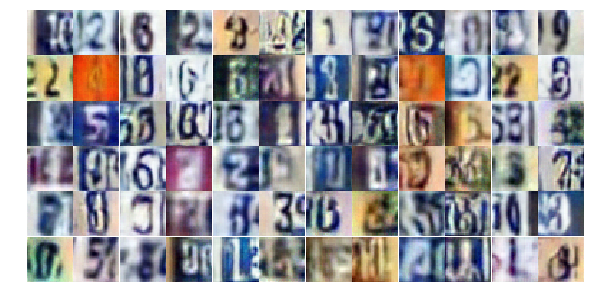

Epoch 13/20... Discriminator Loss: 1.3011... Generator Loss: 0.4334
Epoch 13/20... Discriminator Loss: 0.6904... Generator Loss: 1.2427
Epoch 13/20... Discriminator Loss: 0.8008... Generator Loss: 0.9481
Epoch 13/20... Discriminator Loss: 1.2413... Generator Loss: 0.4863
Epoch 13/20... Discriminator Loss: 0.5117... Generator Loss: 1.3386
Epoch 13/20... Discriminator Loss: 0.3109... Generator Loss: 2.4254
Epoch 13/20... Discriminator Loss: 0.5373... Generator Loss: 1.2726
Epoch 13/20... Discriminator Loss: 1.0278... Generator Loss: 0.6813
Epoch 13/20... Discriminator Loss: 0.5954... Generator Loss: 1.1226
Epoch 13/20... Discriminator Loss: 0.7318... Generator Loss: 0.9261


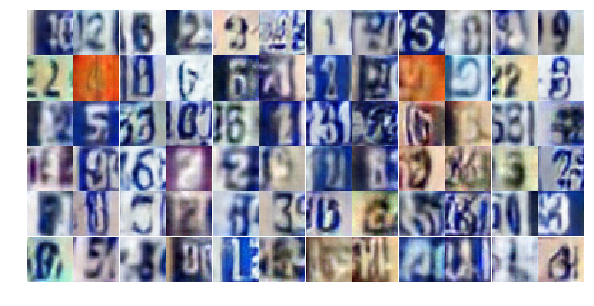

Epoch 13/20... Discriminator Loss: 0.5432... Generator Loss: 1.4766
Epoch 13/20... Discriminator Loss: 0.5466... Generator Loss: 1.3322
Epoch 13/20... Discriminator Loss: 0.6618... Generator Loss: 1.0697
Epoch 13/20... Discriminator Loss: 0.6269... Generator Loss: 1.1222
Epoch 13/20... Discriminator Loss: 1.1313... Generator Loss: 0.5753
Epoch 13/20... Discriminator Loss: 0.7690... Generator Loss: 0.8766
Epoch 13/20... Discriminator Loss: 0.8124... Generator Loss: 0.8262
Epoch 13/20... Discriminator Loss: 0.7795... Generator Loss: 0.9154
Epoch 13/20... Discriminator Loss: 0.5545... Generator Loss: 1.2733
Epoch 13/20... Discriminator Loss: 1.2657... Generator Loss: 0.4747


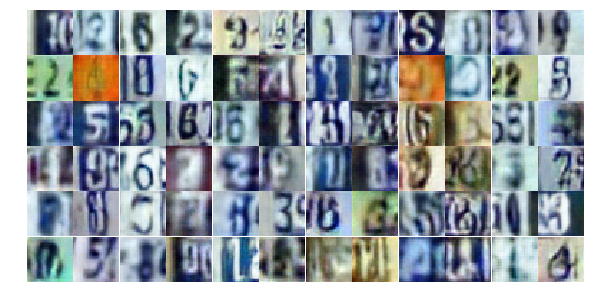

Epoch 13/20... Discriminator Loss: 0.3052... Generator Loss: 2.3414
Epoch 13/20... Discriminator Loss: 1.2006... Generator Loss: 0.5769
Epoch 13/20... Discriminator Loss: 0.7293... Generator Loss: 1.2610
Epoch 13/20... Discriminator Loss: 0.9804... Generator Loss: 0.7049
Epoch 14/20... Discriminator Loss: 1.1177... Generator Loss: 0.5573
Epoch 14/20... Discriminator Loss: 0.7045... Generator Loss: 1.1878
Epoch 14/20... Discriminator Loss: 0.8062... Generator Loss: 0.9210
Epoch 14/20... Discriminator Loss: 0.6730... Generator Loss: 1.7523
Epoch 14/20... Discriminator Loss: 0.5838... Generator Loss: 1.1567
Epoch 14/20... Discriminator Loss: 1.0528... Generator Loss: 0.5940


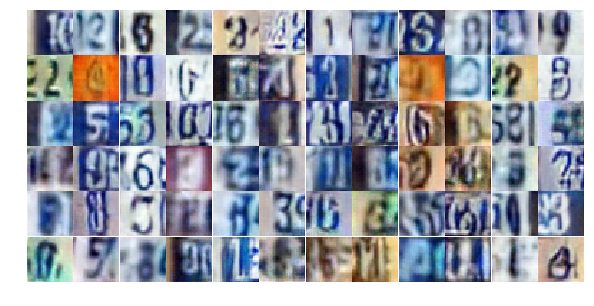

Epoch 14/20... Discriminator Loss: 1.4026... Generator Loss: 2.9796
Epoch 14/20... Discriminator Loss: 1.1816... Generator Loss: 0.4808
Epoch 14/20... Discriminator Loss: 0.5266... Generator Loss: 1.3642
Epoch 14/20... Discriminator Loss: 0.6491... Generator Loss: 1.1338
Epoch 14/20... Discriminator Loss: 1.3910... Generator Loss: 0.3836
Epoch 14/20... Discriminator Loss: 0.4459... Generator Loss: 1.2917
Epoch 14/20... Discriminator Loss: 0.3319... Generator Loss: 2.0021
Epoch 14/20... Discriminator Loss: 1.3327... Generator Loss: 0.4887
Epoch 14/20... Discriminator Loss: 0.8439... Generator Loss: 1.0556
Epoch 14/20... Discriminator Loss: 1.7587... Generator Loss: 0.2706


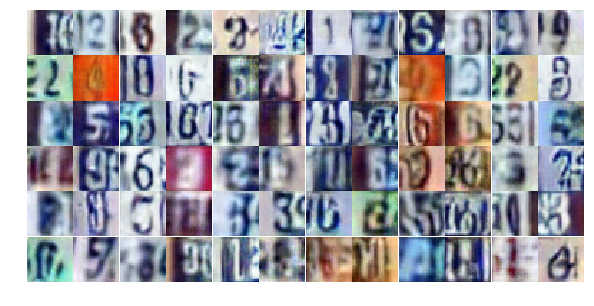

Epoch 14/20... Discriminator Loss: 0.6684... Generator Loss: 1.0228
Epoch 14/20... Discriminator Loss: 0.6103... Generator Loss: 2.2251
Epoch 14/20... Discriminator Loss: 1.0843... Generator Loss: 0.6082
Epoch 14/20... Discriminator Loss: 0.4374... Generator Loss: 1.7158
Epoch 14/20... Discriminator Loss: 0.8592... Generator Loss: 0.9106
Epoch 14/20... Discriminator Loss: 0.7298... Generator Loss: 0.9558
Epoch 14/20... Discriminator Loss: 0.6597... Generator Loss: 1.0770
Epoch 14/20... Discriminator Loss: 0.6222... Generator Loss: 1.0644
Epoch 14/20... Discriminator Loss: 0.6251... Generator Loss: 1.1064
Epoch 14/20... Discriminator Loss: 0.4514... Generator Loss: 1.4088


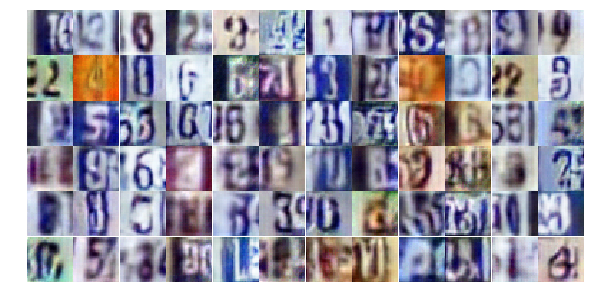

Epoch 14/20... Discriminator Loss: 0.9792... Generator Loss: 0.7043
Epoch 14/20... Discriminator Loss: 0.5872... Generator Loss: 1.2011
Epoch 14/20... Discriminator Loss: 0.4639... Generator Loss: 1.3337
Epoch 14/20... Discriminator Loss: 0.4583... Generator Loss: 1.3107
Epoch 14/20... Discriminator Loss: 0.6956... Generator Loss: 2.0581
Epoch 14/20... Discriminator Loss: 0.6419... Generator Loss: 1.2055
Epoch 14/20... Discriminator Loss: 0.8318... Generator Loss: 0.8014
Epoch 14/20... Discriminator Loss: 0.4774... Generator Loss: 1.3590
Epoch 14/20... Discriminator Loss: 0.3709... Generator Loss: 1.9754
Epoch 14/20... Discriminator Loss: 1.0224... Generator Loss: 2.4375


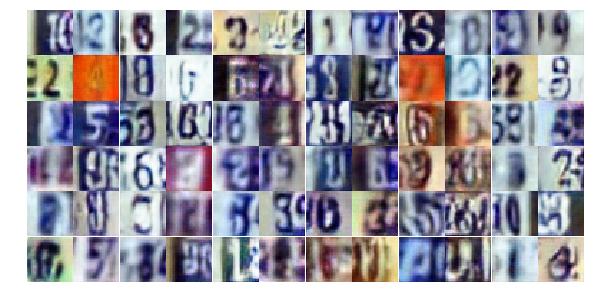

Epoch 14/20... Discriminator Loss: 1.3598... Generator Loss: 0.4173
Epoch 14/20... Discriminator Loss: 0.6227... Generator Loss: 1.1855
Epoch 14/20... Discriminator Loss: 1.0542... Generator Loss: 0.5662
Epoch 14/20... Discriminator Loss: 1.1480... Generator Loss: 0.5410
Epoch 14/20... Discriminator Loss: 0.8849... Generator Loss: 0.7384
Epoch 14/20... Discriminator Loss: 0.6724... Generator Loss: 1.1989
Epoch 14/20... Discriminator Loss: 0.6142... Generator Loss: 1.2533
Epoch 14/20... Discriminator Loss: 0.4832... Generator Loss: 1.4582
Epoch 14/20... Discriminator Loss: 1.8991... Generator Loss: 2.5547
Epoch 14/20... Discriminator Loss: 1.5765... Generator Loss: 0.3836


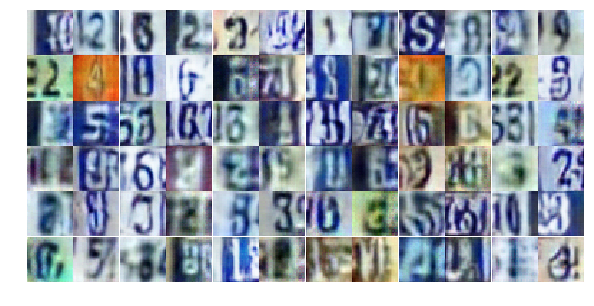

Epoch 14/20... Discriminator Loss: 0.9694... Generator Loss: 1.6482
Epoch 14/20... Discriminator Loss: 1.0060... Generator Loss: 0.7038
Epoch 14/20... Discriminator Loss: 0.5297... Generator Loss: 1.4737
Epoch 14/20... Discriminator Loss: 0.7295... Generator Loss: 0.9793
Epoch 14/20... Discriminator Loss: 0.5482... Generator Loss: 1.2520
Epoch 14/20... Discriminator Loss: 0.7529... Generator Loss: 0.8457
Epoch 14/20... Discriminator Loss: 0.8752... Generator Loss: 2.9837
Epoch 14/20... Discriminator Loss: 0.9135... Generator Loss: 0.7157
Epoch 14/20... Discriminator Loss: 1.4239... Generator Loss: 0.3750
Epoch 14/20... Discriminator Loss: 0.9934... Generator Loss: 0.6945


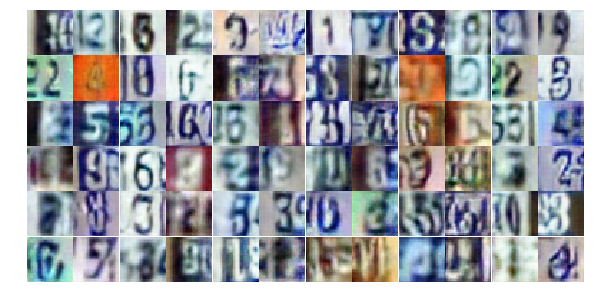

Epoch 14/20... Discriminator Loss: 0.6540... Generator Loss: 2.4459
Epoch 14/20... Discriminator Loss: 0.9583... Generator Loss: 0.7071
Epoch 15/20... Discriminator Loss: 0.5312... Generator Loss: 1.3315
Epoch 15/20... Discriminator Loss: 0.4267... Generator Loss: 1.5614
Epoch 15/20... Discriminator Loss: 0.6357... Generator Loss: 1.0385
Epoch 15/20... Discriminator Loss: 0.8122... Generator Loss: 0.8113
Epoch 15/20... Discriminator Loss: 1.0539... Generator Loss: 0.6132
Epoch 15/20... Discriminator Loss: 0.6331... Generator Loss: 1.6562
Epoch 15/20... Discriminator Loss: 1.7927... Generator Loss: 0.3020
Epoch 15/20... Discriminator Loss: 0.7692... Generator Loss: 0.9232


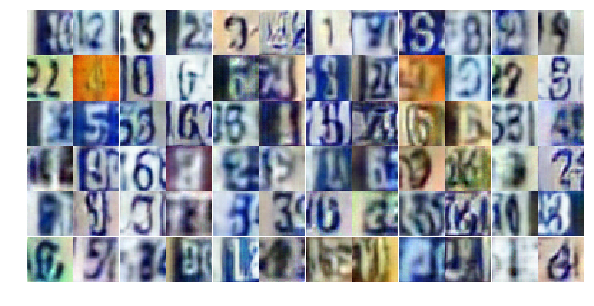

Epoch 15/20... Discriminator Loss: 0.8273... Generator Loss: 0.8336
Epoch 15/20... Discriminator Loss: 0.9596... Generator Loss: 0.7300
Epoch 15/20... Discriminator Loss: 0.9769... Generator Loss: 0.6364
Epoch 15/20... Discriminator Loss: 0.5970... Generator Loss: 1.0938
Epoch 15/20... Discriminator Loss: 1.1190... Generator Loss: 0.5708
Epoch 15/20... Discriminator Loss: 0.5699... Generator Loss: 1.2164
Epoch 15/20... Discriminator Loss: 0.9546... Generator Loss: 0.7568
Epoch 15/20... Discriminator Loss: 0.6865... Generator Loss: 1.3925
Epoch 15/20... Discriminator Loss: 0.9694... Generator Loss: 3.3233
Epoch 15/20... Discriminator Loss: 4.5732... Generator Loss: 0.0253


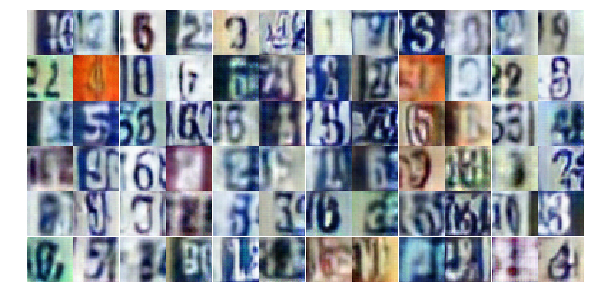

Epoch 15/20... Discriminator Loss: 2.6165... Generator Loss: 0.1305
Epoch 15/20... Discriminator Loss: 0.7171... Generator Loss: 1.2022
Epoch 15/20... Discriminator Loss: 0.5014... Generator Loss: 1.6863
Epoch 15/20... Discriminator Loss: 0.8888... Generator Loss: 0.8814
Epoch 15/20... Discriminator Loss: 0.9188... Generator Loss: 0.8277
Epoch 15/20... Discriminator Loss: 0.5201... Generator Loss: 1.5099
Epoch 15/20... Discriminator Loss: 0.7866... Generator Loss: 0.9108
Epoch 15/20... Discriminator Loss: 1.0085... Generator Loss: 0.5889
Epoch 15/20... Discriminator Loss: 0.6039... Generator Loss: 1.1128
Epoch 15/20... Discriminator Loss: 1.1581... Generator Loss: 0.5421


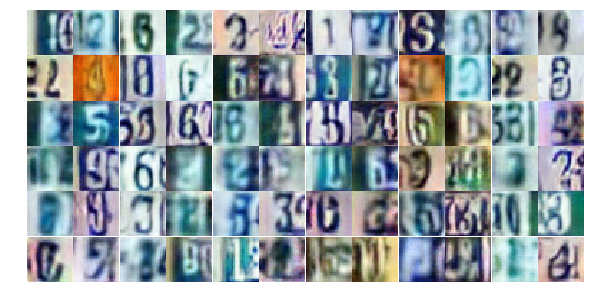

Epoch 15/20... Discriminator Loss: 0.8562... Generator Loss: 0.8369
Epoch 15/20... Discriminator Loss: 0.6526... Generator Loss: 1.3260
Epoch 15/20... Discriminator Loss: 0.4611... Generator Loss: 1.3138
Epoch 15/20... Discriminator Loss: 0.5607... Generator Loss: 1.2204
Epoch 15/20... Discriminator Loss: 0.5384... Generator Loss: 1.3553
Epoch 15/20... Discriminator Loss: 0.7468... Generator Loss: 1.4881
Epoch 15/20... Discriminator Loss: 0.4574... Generator Loss: 1.6089
Epoch 15/20... Discriminator Loss: 0.7254... Generator Loss: 0.8823
Epoch 15/20... Discriminator Loss: 0.4419... Generator Loss: 1.6394
Epoch 15/20... Discriminator Loss: 0.6789... Generator Loss: 1.0494


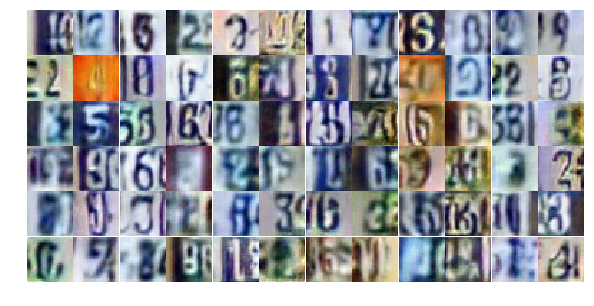

Epoch 15/20... Discriminator Loss: 0.7350... Generator Loss: 0.9150
Epoch 15/20... Discriminator Loss: 0.8754... Generator Loss: 0.7598
Epoch 15/20... Discriminator Loss: 1.0494... Generator Loss: 0.6047
Epoch 15/20... Discriminator Loss: 0.5158... Generator Loss: 1.2667
Epoch 15/20... Discriminator Loss: 0.5639... Generator Loss: 1.2517
Epoch 15/20... Discriminator Loss: 1.7416... Generator Loss: 0.2787
Epoch 15/20... Discriminator Loss: 0.3881... Generator Loss: 1.7551
Epoch 15/20... Discriminator Loss: 1.0100... Generator Loss: 2.4526
Epoch 15/20... Discriminator Loss: 0.8331... Generator Loss: 0.8077
Epoch 15/20... Discriminator Loss: 0.6688... Generator Loss: 1.3302


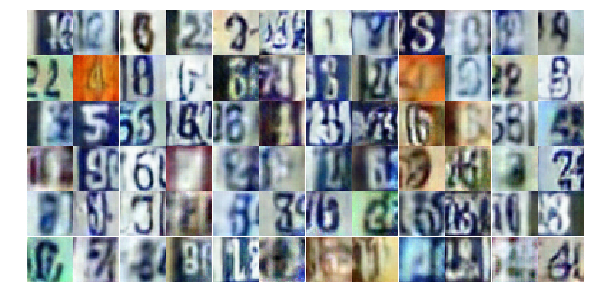

Epoch 15/20... Discriminator Loss: 1.0404... Generator Loss: 0.7033
Epoch 15/20... Discriminator Loss: 0.7326... Generator Loss: 1.1770
Epoch 15/20... Discriminator Loss: 0.4306... Generator Loss: 1.6272
Epoch 15/20... Discriminator Loss: 1.3862... Generator Loss: 0.4121
Epoch 15/20... Discriminator Loss: 0.6191... Generator Loss: 1.2035
Epoch 15/20... Discriminator Loss: 0.7468... Generator Loss: 0.9962
Epoch 15/20... Discriminator Loss: 0.7252... Generator Loss: 1.0278
Epoch 15/20... Discriminator Loss: 0.4630... Generator Loss: 1.6580
Epoch 15/20... Discriminator Loss: 1.3538... Generator Loss: 0.3855
Epoch 16/20... Discriminator Loss: 1.2439... Generator Loss: 0.4888


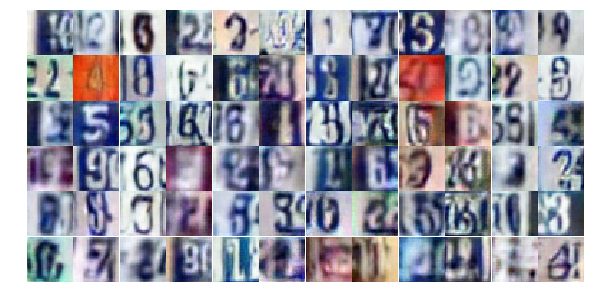

Epoch 16/20... Discriminator Loss: 0.4811... Generator Loss: 1.4540
Epoch 16/20... Discriminator Loss: 0.7598... Generator Loss: 0.9902
Epoch 16/20... Discriminator Loss: 0.7200... Generator Loss: 1.0628
Epoch 16/20... Discriminator Loss: 0.6330... Generator Loss: 1.2277
Epoch 16/20... Discriminator Loss: 0.8163... Generator Loss: 2.1367
Epoch 16/20... Discriminator Loss: 0.5668... Generator Loss: 1.4140
Epoch 16/20... Discriminator Loss: 1.2369... Generator Loss: 0.4986
Epoch 16/20... Discriminator Loss: 0.8467... Generator Loss: 0.7763
Epoch 16/20... Discriminator Loss: 0.5524... Generator Loss: 1.2460
Epoch 16/20... Discriminator Loss: 0.4485... Generator Loss: 1.4594


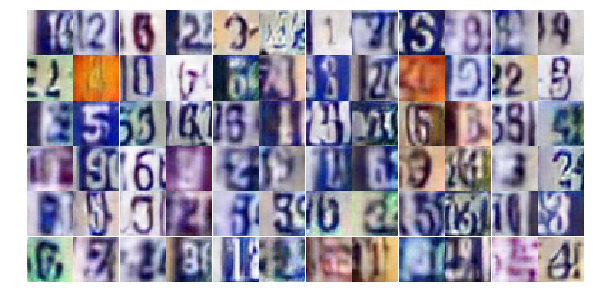

Epoch 16/20... Discriminator Loss: 1.5311... Generator Loss: 0.3472
Epoch 16/20... Discriminator Loss: 1.2578... Generator Loss: 0.5053
Epoch 16/20... Discriminator Loss: 1.3354... Generator Loss: 0.4920
Epoch 16/20... Discriminator Loss: 0.9757... Generator Loss: 0.6755
Epoch 16/20... Discriminator Loss: 0.4374... Generator Loss: 1.5745
Epoch 16/20... Discriminator Loss: 0.8667... Generator Loss: 0.7327
Epoch 16/20... Discriminator Loss: 1.8741... Generator Loss: 0.2834
Epoch 16/20... Discriminator Loss: 0.3476... Generator Loss: 2.1501
Epoch 16/20... Discriminator Loss: 0.5814... Generator Loss: 1.2433
Epoch 16/20... Discriminator Loss: 0.7241... Generator Loss: 1.0658


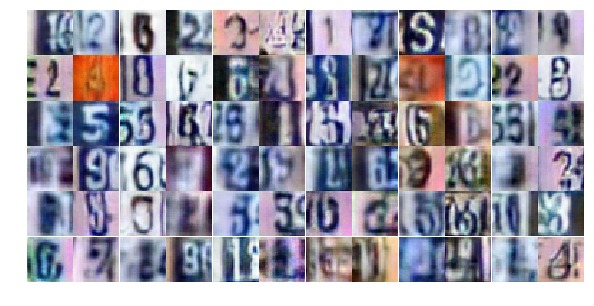

Epoch 16/20... Discriminator Loss: 0.6318... Generator Loss: 1.1420
Epoch 16/20... Discriminator Loss: 0.5939... Generator Loss: 1.2325
Epoch 16/20... Discriminator Loss: 0.7989... Generator Loss: 0.8367
Epoch 16/20... Discriminator Loss: 0.6710... Generator Loss: 1.1154
Epoch 16/20... Discriminator Loss: 0.5995... Generator Loss: 1.2229
Epoch 16/20... Discriminator Loss: 0.6504... Generator Loss: 1.2154
Epoch 16/20... Discriminator Loss: 0.7399... Generator Loss: 0.8711
Epoch 16/20... Discriminator Loss: 0.5814... Generator Loss: 1.1230
Epoch 16/20... Discriminator Loss: 0.7412... Generator Loss: 1.6988
Epoch 16/20... Discriminator Loss: 0.6678... Generator Loss: 1.0678


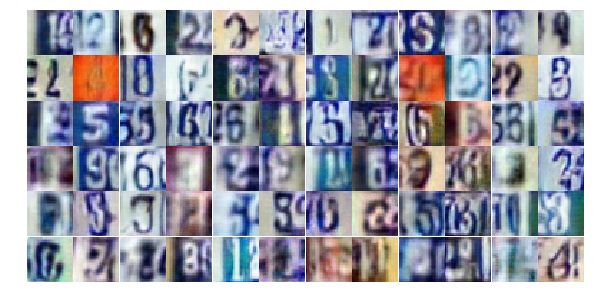

Epoch 16/20... Discriminator Loss: 0.5258... Generator Loss: 1.2095
Epoch 16/20... Discriminator Loss: 0.6003... Generator Loss: 1.1633
Epoch 16/20... Discriminator Loss: 0.5456... Generator Loss: 1.3214
Epoch 16/20... Discriminator Loss: 1.3612... Generator Loss: 0.4159
Epoch 16/20... Discriminator Loss: 1.0648... Generator Loss: 0.6246
Epoch 16/20... Discriminator Loss: 1.2361... Generator Loss: 2.9738
Epoch 16/20... Discriminator Loss: 0.7804... Generator Loss: 0.8820
Epoch 16/20... Discriminator Loss: 0.9900... Generator Loss: 0.6023
Epoch 16/20... Discriminator Loss: 1.1273... Generator Loss: 0.5760
Epoch 16/20... Discriminator Loss: 0.4598... Generator Loss: 1.7089


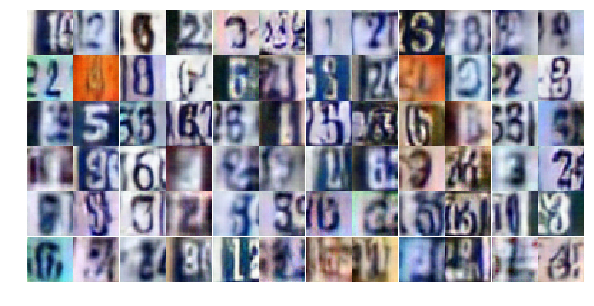

Epoch 16/20... Discriminator Loss: 0.5595... Generator Loss: 1.3325
Epoch 16/20... Discriminator Loss: 0.5854... Generator Loss: 1.2174
Epoch 16/20... Discriminator Loss: 1.6718... Generator Loss: 0.3316
Epoch 16/20... Discriminator Loss: 0.6609... Generator Loss: 1.2520
Epoch 16/20... Discriminator Loss: 0.8084... Generator Loss: 0.8517
Epoch 16/20... Discriminator Loss: 1.1292... Generator Loss: 0.5496
Epoch 16/20... Discriminator Loss: 0.4981... Generator Loss: 1.4678
Epoch 16/20... Discriminator Loss: 0.6568... Generator Loss: 1.0997
Epoch 16/20... Discriminator Loss: 0.5647... Generator Loss: 1.1170
Epoch 16/20... Discriminator Loss: 0.8538... Generator Loss: 0.8166


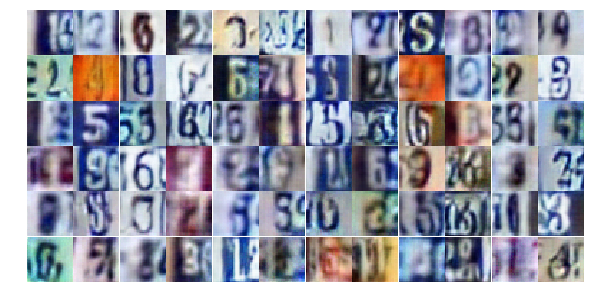

Epoch 16/20... Discriminator Loss: 1.2842... Generator Loss: 0.4629
Epoch 16/20... Discriminator Loss: 1.0304... Generator Loss: 0.6051
Epoch 16/20... Discriminator Loss: 2.0129... Generator Loss: 0.2193
Epoch 16/20... Discriminator Loss: 0.5428... Generator Loss: 1.2186
Epoch 16/20... Discriminator Loss: 0.5743... Generator Loss: 1.1538
Epoch 16/20... Discriminator Loss: 0.5878... Generator Loss: 1.3411
Epoch 17/20... Discriminator Loss: 0.8284... Generator Loss: 0.8701
Epoch 17/20... Discriminator Loss: 0.8329... Generator Loss: 0.8323
Epoch 17/20... Discriminator Loss: 0.5998... Generator Loss: 1.1073
Epoch 17/20... Discriminator Loss: 0.7862... Generator Loss: 0.9179


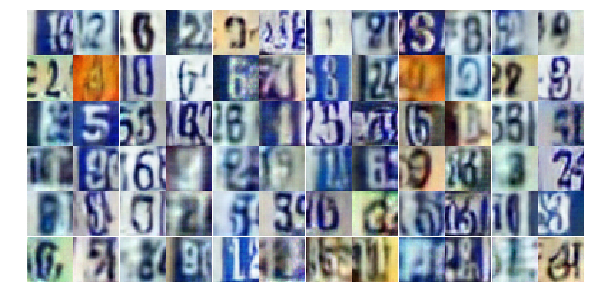

Epoch 17/20... Discriminator Loss: 0.5102... Generator Loss: 1.6058
Epoch 17/20... Discriminator Loss: 0.5040... Generator Loss: 1.3341
Epoch 17/20... Discriminator Loss: 0.7712... Generator Loss: 0.9876
Epoch 17/20... Discriminator Loss: 0.8549... Generator Loss: 0.7776
Epoch 17/20... Discriminator Loss: 1.2759... Generator Loss: 0.4334
Epoch 17/20... Discriminator Loss: 0.8294... Generator Loss: 0.8774
Epoch 17/20... Discriminator Loss: 0.8715... Generator Loss: 0.7861
Epoch 17/20... Discriminator Loss: 0.6032... Generator Loss: 1.0529
Epoch 17/20... Discriminator Loss: 0.3638... Generator Loss: 1.6735
Epoch 17/20... Discriminator Loss: 0.6945... Generator Loss: 0.9453


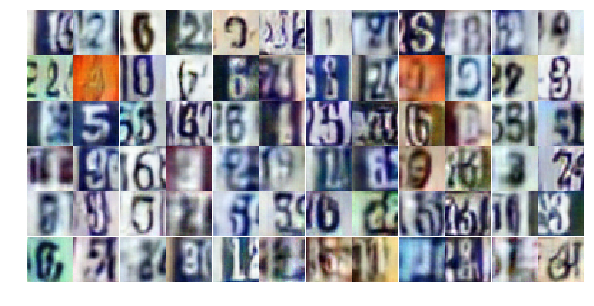

Epoch 17/20... Discriminator Loss: 0.7901... Generator Loss: 1.3147
Epoch 17/20... Discriminator Loss: 0.9654... Generator Loss: 0.7156
Epoch 17/20... Discriminator Loss: 0.4511... Generator Loss: 1.5269
Epoch 17/20... Discriminator Loss: 6.0981... Generator Loss: 0.0094
Epoch 17/20... Discriminator Loss: 1.2050... Generator Loss: 1.9471
Epoch 17/20... Discriminator Loss: 1.0382... Generator Loss: 0.9677
Epoch 17/20... Discriminator Loss: 0.6878... Generator Loss: 1.2489
Epoch 17/20... Discriminator Loss: 0.8032... Generator Loss: 0.9902
Epoch 17/20... Discriminator Loss: 0.6221... Generator Loss: 1.0607
Epoch 17/20... Discriminator Loss: 0.6784... Generator Loss: 1.0549


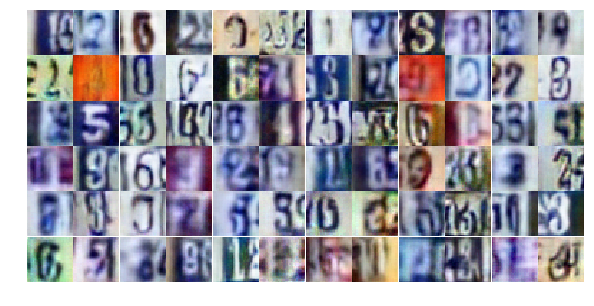

Epoch 17/20... Discriminator Loss: 1.4180... Generator Loss: 0.3797
Epoch 17/20... Discriminator Loss: 0.5513... Generator Loss: 1.2796
Epoch 17/20... Discriminator Loss: 0.6596... Generator Loss: 1.1040
Epoch 17/20... Discriminator Loss: 1.0603... Generator Loss: 0.6409
Epoch 17/20... Discriminator Loss: 1.7229... Generator Loss: 0.3064
Epoch 17/20... Discriminator Loss: 0.6379... Generator Loss: 1.0299
Epoch 17/20... Discriminator Loss: 0.7153... Generator Loss: 0.9953
Epoch 17/20... Discriminator Loss: 0.9336... Generator Loss: 0.6892
Epoch 17/20... Discriminator Loss: 1.0419... Generator Loss: 0.7174
Epoch 17/20... Discriminator Loss: 0.3822... Generator Loss: 1.7831


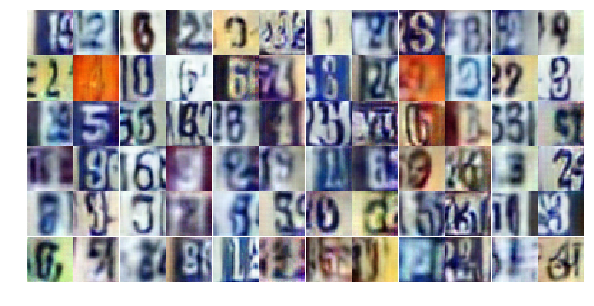

Epoch 17/20... Discriminator Loss: 0.5905... Generator Loss: 1.4409
Epoch 17/20... Discriminator Loss: 0.7697... Generator Loss: 1.0580
Epoch 17/20... Discriminator Loss: 0.5372... Generator Loss: 1.4723
Epoch 17/20... Discriminator Loss: 0.7323... Generator Loss: 1.3337
Epoch 17/20... Discriminator Loss: 0.8598... Generator Loss: 0.7391
Epoch 17/20... Discriminator Loss: 0.9187... Generator Loss: 0.7119
Epoch 17/20... Discriminator Loss: 1.0197... Generator Loss: 0.6714
Epoch 17/20... Discriminator Loss: 0.5518... Generator Loss: 1.2435
Epoch 17/20... Discriminator Loss: 0.3418... Generator Loss: 2.0029
Epoch 17/20... Discriminator Loss: 0.7241... Generator Loss: 0.9100


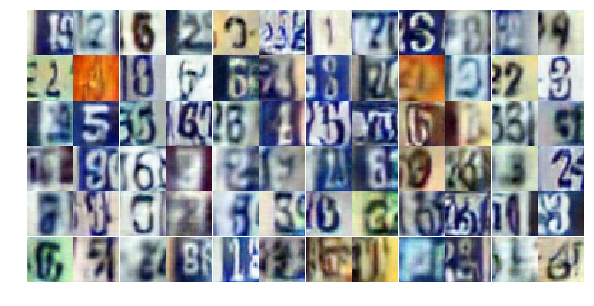

Epoch 17/20... Discriminator Loss: 1.4085... Generator Loss: 2.9712
Epoch 17/20... Discriminator Loss: 0.4354... Generator Loss: 1.7642
Epoch 17/20... Discriminator Loss: 0.8000... Generator Loss: 1.0553
Epoch 17/20... Discriminator Loss: 0.5261... Generator Loss: 1.1854
Epoch 17/20... Discriminator Loss: 0.8378... Generator Loss: 0.8550
Epoch 17/20... Discriminator Loss: 0.9709... Generator Loss: 0.6567
Epoch 17/20... Discriminator Loss: 1.0901... Generator Loss: 0.5704
Epoch 17/20... Discriminator Loss: 0.6383... Generator Loss: 1.3789
Epoch 17/20... Discriminator Loss: 0.6260... Generator Loss: 1.2572
Epoch 17/20... Discriminator Loss: 1.4124... Generator Loss: 0.4170


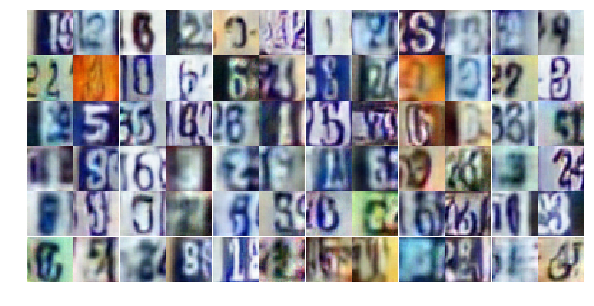

Epoch 17/20... Discriminator Loss: 0.7157... Generator Loss: 1.0936
Epoch 17/20... Discriminator Loss: 0.9179... Generator Loss: 0.7699
Epoch 17/20... Discriminator Loss: 0.4625... Generator Loss: 1.4075
Epoch 17/20... Discriminator Loss: 0.6262... Generator Loss: 1.2595
Epoch 18/20... Discriminator Loss: 1.0733... Generator Loss: 0.6207
Epoch 18/20... Discriminator Loss: 0.6902... Generator Loss: 0.9775
Epoch 18/20... Discriminator Loss: 0.8418... Generator Loss: 0.7929
Epoch 18/20... Discriminator Loss: 0.7481... Generator Loss: 0.8973
Epoch 18/20... Discriminator Loss: 0.8219... Generator Loss: 0.8235
Epoch 18/20... Discriminator Loss: 0.7661... Generator Loss: 0.9863


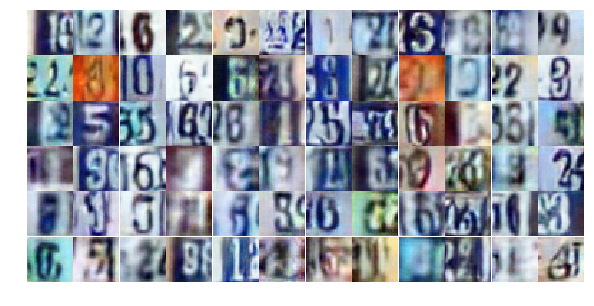

Epoch 18/20... Discriminator Loss: 0.4119... Generator Loss: 2.1245
Epoch 18/20... Discriminator Loss: 1.1812... Generator Loss: 0.5404
Epoch 18/20... Discriminator Loss: 0.6194... Generator Loss: 1.0767
Epoch 18/20... Discriminator Loss: 0.5652... Generator Loss: 1.3008
Epoch 18/20... Discriminator Loss: 0.4622... Generator Loss: 1.4381
Epoch 18/20... Discriminator Loss: 1.2389... Generator Loss: 0.5006
Epoch 18/20... Discriminator Loss: 0.5515... Generator Loss: 1.2116
Epoch 18/20... Discriminator Loss: 0.6896... Generator Loss: 1.0086
Epoch 18/20... Discriminator Loss: 0.6643... Generator Loss: 1.9777
Epoch 18/20... Discriminator Loss: 0.4536... Generator Loss: 1.4936


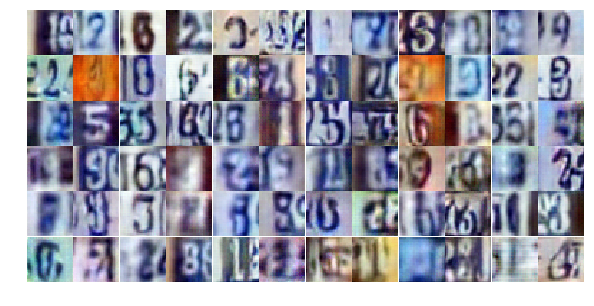

Epoch 18/20... Discriminator Loss: 0.5252... Generator Loss: 1.4301
Epoch 18/20... Discriminator Loss: 1.0505... Generator Loss: 0.6916
Epoch 18/20... Discriminator Loss: 0.8684... Generator Loss: 0.9507
Epoch 18/20... Discriminator Loss: 0.5305... Generator Loss: 1.3070
Epoch 18/20... Discriminator Loss: 0.8239... Generator Loss: 0.8051
Epoch 18/20... Discriminator Loss: 0.8530... Generator Loss: 1.6961
Epoch 18/20... Discriminator Loss: 0.9220... Generator Loss: 0.7644
Epoch 18/20... Discriminator Loss: 1.1899... Generator Loss: 0.5956
Epoch 18/20... Discriminator Loss: 0.8468... Generator Loss: 0.8413
Epoch 18/20... Discriminator Loss: 0.5971... Generator Loss: 1.0803


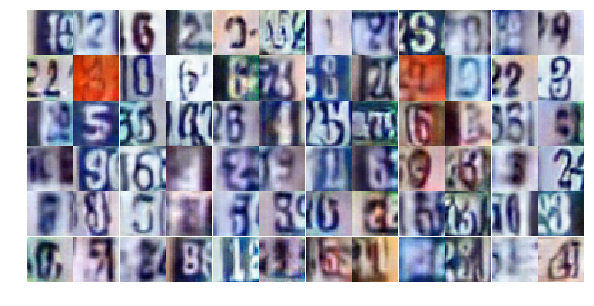

Epoch 18/20... Discriminator Loss: 0.5285... Generator Loss: 1.2583
Epoch 18/20... Discriminator Loss: 0.7367... Generator Loss: 1.1016
Epoch 18/20... Discriminator Loss: 0.9295... Generator Loss: 2.0929
Epoch 18/20... Discriminator Loss: 0.7762... Generator Loss: 0.9168
Epoch 18/20... Discriminator Loss: 0.7373... Generator Loss: 0.9187
Epoch 18/20... Discriminator Loss: 0.6703... Generator Loss: 1.1629
Epoch 18/20... Discriminator Loss: 1.0580... Generator Loss: 0.6370
Epoch 18/20... Discriminator Loss: 0.4938... Generator Loss: 1.3513
Epoch 18/20... Discriminator Loss: 0.4823... Generator Loss: 1.3723
Epoch 18/20... Discriminator Loss: 0.6980... Generator Loss: 1.0684


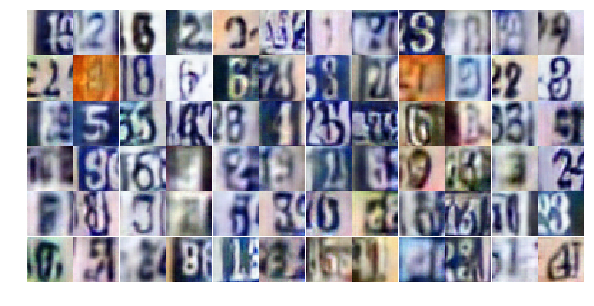

Epoch 18/20... Discriminator Loss: 0.6359... Generator Loss: 1.2276
Epoch 18/20... Discriminator Loss: 0.5413... Generator Loss: 1.3092
Epoch 18/20... Discriminator Loss: 0.7389... Generator Loss: 0.9134
Epoch 18/20... Discriminator Loss: 0.9541... Generator Loss: 0.6745
Epoch 18/20... Discriminator Loss: 0.5535... Generator Loss: 1.6067
Epoch 18/20... Discriminator Loss: 0.3084... Generator Loss: 1.8072
Epoch 18/20... Discriminator Loss: 1.0468... Generator Loss: 0.5994
Epoch 18/20... Discriminator Loss: 2.5685... Generator Loss: 4.4538
Epoch 18/20... Discriminator Loss: 1.9974... Generator Loss: 0.2181
Epoch 18/20... Discriminator Loss: 0.8050... Generator Loss: 0.9706


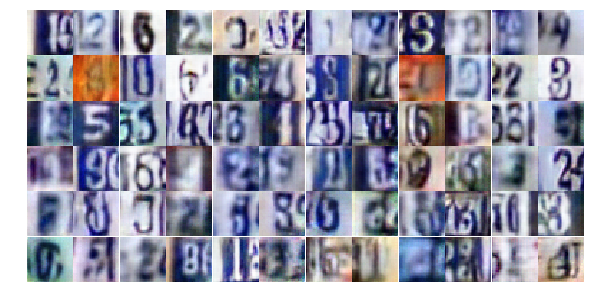

Epoch 18/20... Discriminator Loss: 0.7319... Generator Loss: 0.9338
Epoch 18/20... Discriminator Loss: 0.7645... Generator Loss: 0.9614
Epoch 18/20... Discriminator Loss: 0.6930... Generator Loss: 1.1150
Epoch 18/20... Discriminator Loss: 0.6873... Generator Loss: 1.2743
Epoch 18/20... Discriminator Loss: 0.4724... Generator Loss: 1.3671
Epoch 18/20... Discriminator Loss: 0.7759... Generator Loss: 0.8510
Epoch 18/20... Discriminator Loss: 0.6192... Generator Loss: 1.3709
Epoch 18/20... Discriminator Loss: 0.4629... Generator Loss: 1.5049
Epoch 18/20... Discriminator Loss: 0.9990... Generator Loss: 0.6941
Epoch 18/20... Discriminator Loss: 0.9728... Generator Loss: 0.7649


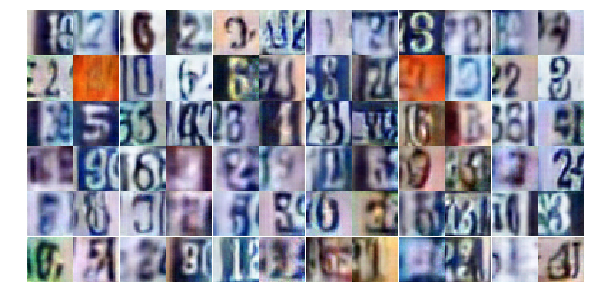

Epoch 18/20... Discriminator Loss: 0.6879... Generator Loss: 1.9320
Epoch 19/20... Discriminator Loss: 1.2318... Generator Loss: 0.4973
Epoch 19/20... Discriminator Loss: 1.1949... Generator Loss: 0.5398
Epoch 19/20... Discriminator Loss: 0.7837... Generator Loss: 1.0059
Epoch 19/20... Discriminator Loss: 0.5938... Generator Loss: 1.1264
Epoch 19/20... Discriminator Loss: 0.9695... Generator Loss: 0.7397
Epoch 19/20... Discriminator Loss: 0.4282... Generator Loss: 1.5217
Epoch 19/20... Discriminator Loss: 1.1557... Generator Loss: 0.5723
Epoch 19/20... Discriminator Loss: 0.7411... Generator Loss: 3.1515
Epoch 19/20... Discriminator Loss: 0.7205... Generator Loss: 1.9007


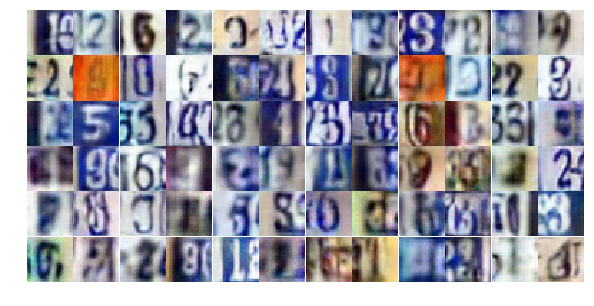

Epoch 19/20... Discriminator Loss: 0.6757... Generator Loss: 0.9873
Epoch 19/20... Discriminator Loss: 0.9105... Generator Loss: 0.7579
Epoch 19/20... Discriminator Loss: 0.7173... Generator Loss: 1.0551
Epoch 19/20... Discriminator Loss: 1.0450... Generator Loss: 0.5950
Epoch 19/20... Discriminator Loss: 0.8076... Generator Loss: 0.8391
Epoch 19/20... Discriminator Loss: 0.9392... Generator Loss: 0.7482
Epoch 19/20... Discriminator Loss: 0.9350... Generator Loss: 0.7286
Epoch 19/20... Discriminator Loss: 0.6879... Generator Loss: 1.0106
Epoch 19/20... Discriminator Loss: 0.9496... Generator Loss: 0.7614
Epoch 19/20... Discriminator Loss: 1.0931... Generator Loss: 0.6382


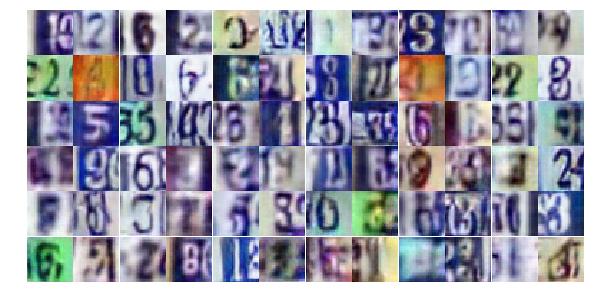

Epoch 19/20... Discriminator Loss: 0.6055... Generator Loss: 1.1599
Epoch 19/20... Discriminator Loss: 1.6162... Generator Loss: 0.3258
Epoch 19/20... Discriminator Loss: 1.2740... Generator Loss: 0.4798
Epoch 19/20... Discriminator Loss: 0.8489... Generator Loss: 0.7912
Epoch 19/20... Discriminator Loss: 1.1051... Generator Loss: 0.6079
Epoch 19/20... Discriminator Loss: 0.7590... Generator Loss: 1.1814
Epoch 19/20... Discriminator Loss: 0.7711... Generator Loss: 0.9363
Epoch 19/20... Discriminator Loss: 0.5874... Generator Loss: 1.2013
Epoch 19/20... Discriminator Loss: 1.1382... Generator Loss: 0.5383
Epoch 19/20... Discriminator Loss: 0.9484... Generator Loss: 0.6750


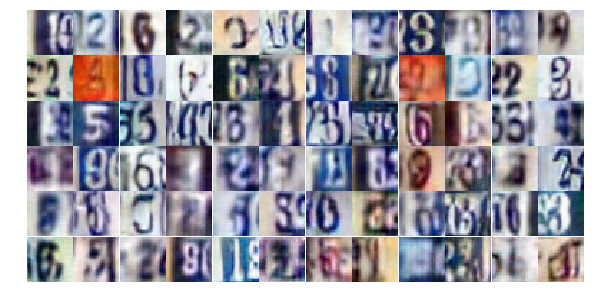

Epoch 19/20... Discriminator Loss: 0.7303... Generator Loss: 0.9496
Epoch 19/20... Discriminator Loss: 0.7071... Generator Loss: 0.9783
Epoch 19/20... Discriminator Loss: 1.2765... Generator Loss: 0.4606
Epoch 19/20... Discriminator Loss: 0.5518... Generator Loss: 1.3984
Epoch 19/20... Discriminator Loss: 0.8029... Generator Loss: 1.0087
Epoch 19/20... Discriminator Loss: 1.3955... Generator Loss: 0.4460
Epoch 19/20... Discriminator Loss: 0.5957... Generator Loss: 1.2899
Epoch 19/20... Discriminator Loss: 0.6859... Generator Loss: 0.9587
Epoch 19/20... Discriminator Loss: 0.8770... Generator Loss: 0.7944
Epoch 19/20... Discriminator Loss: 0.5429... Generator Loss: 1.7710


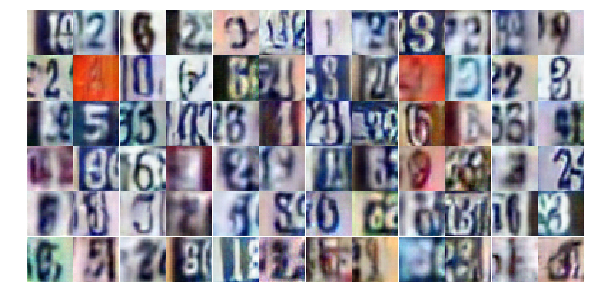

Epoch 19/20... Discriminator Loss: 0.5500... Generator Loss: 1.4719
Epoch 19/20... Discriminator Loss: 0.6910... Generator Loss: 1.0474
Epoch 19/20... Discriminator Loss: 0.6114... Generator Loss: 1.1091
Epoch 19/20... Discriminator Loss: 1.0248... Generator Loss: 0.6621
Epoch 19/20... Discriminator Loss: 1.0960... Generator Loss: 0.5810
Epoch 19/20... Discriminator Loss: 0.4862... Generator Loss: 1.7370
Epoch 19/20... Discriminator Loss: 0.6299... Generator Loss: 1.4937
Epoch 19/20... Discriminator Loss: 0.6859... Generator Loss: 1.1714
Epoch 19/20... Discriminator Loss: 0.6233... Generator Loss: 1.2805
Epoch 19/20... Discriminator Loss: 0.6727... Generator Loss: 1.1428


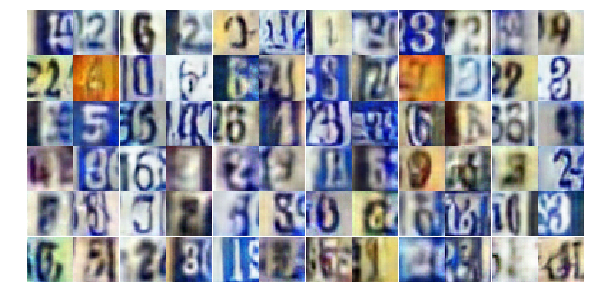

Epoch 19/20... Discriminator Loss: 0.6806... Generator Loss: 1.0716
Epoch 19/20... Discriminator Loss: 0.7385... Generator Loss: 1.0167
Epoch 19/20... Discriminator Loss: 0.5997... Generator Loss: 1.3034
Epoch 19/20... Discriminator Loss: 1.1406... Generator Loss: 0.5519
Epoch 19/20... Discriminator Loss: 0.8226... Generator Loss: 0.8490
Epoch 19/20... Discriminator Loss: 0.7977... Generator Loss: 0.9227
Epoch 19/20... Discriminator Loss: 1.4037... Generator Loss: 0.4161
Epoch 19/20... Discriminator Loss: 0.5323... Generator Loss: 1.4942
Epoch 20/20... Discriminator Loss: 0.6741... Generator Loss: 1.4948
Epoch 20/20... Discriminator Loss: 0.8078... Generator Loss: 0.8999


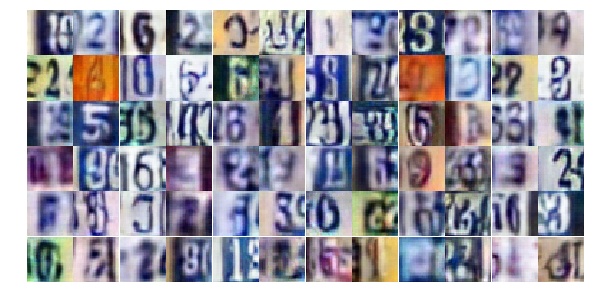

Epoch 20/20... Discriminator Loss: 0.4696... Generator Loss: 1.5161
Epoch 20/20... Discriminator Loss: 0.6928... Generator Loss: 1.0664
Epoch 20/20... Discriminator Loss: 1.8270... Generator Loss: 0.2886
Epoch 20/20... Discriminator Loss: 1.6022... Generator Loss: 0.3562
Epoch 20/20... Discriminator Loss: 0.5210... Generator Loss: 1.5939
Epoch 20/20... Discriminator Loss: 0.8937... Generator Loss: 0.8007
Epoch 20/20... Discriminator Loss: 0.6540... Generator Loss: 1.0495
Epoch 20/20... Discriminator Loss: 0.6913... Generator Loss: 1.1147
Epoch 20/20... Discriminator Loss: 1.1129... Generator Loss: 0.5804
Epoch 20/20... Discriminator Loss: 0.9013... Generator Loss: 0.7824


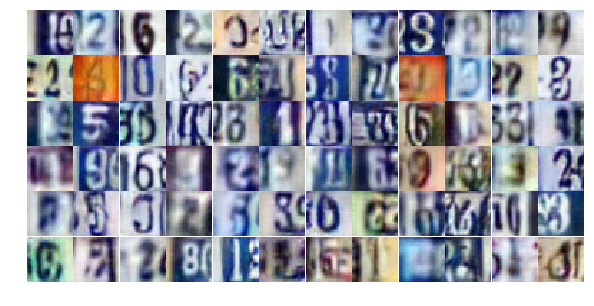

Epoch 20/20... Discriminator Loss: 1.3233... Generator Loss: 0.5202
Epoch 20/20... Discriminator Loss: 1.1347... Generator Loss: 0.6092
Epoch 20/20... Discriminator Loss: 0.6864... Generator Loss: 1.0699
Epoch 20/20... Discriminator Loss: 0.6462... Generator Loss: 1.1329
Epoch 20/20... Discriminator Loss: 0.9690... Generator Loss: 0.6605
Epoch 20/20... Discriminator Loss: 1.4302... Generator Loss: 0.4022
Epoch 20/20... Discriminator Loss: 1.7684... Generator Loss: 0.3177
Epoch 20/20... Discriminator Loss: 0.7869... Generator Loss: 0.8116
Epoch 20/20... Discriminator Loss: 0.4276... Generator Loss: 1.6884
Epoch 20/20... Discriminator Loss: 1.2429... Generator Loss: 0.5264


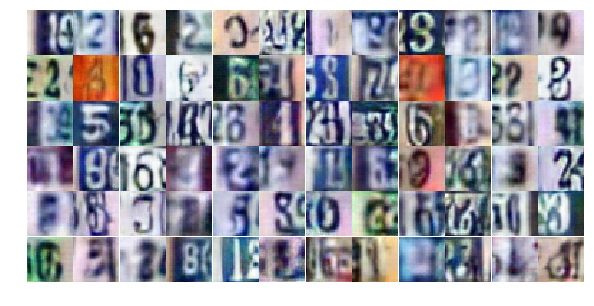

Epoch 20/20... Discriminator Loss: 0.5803... Generator Loss: 1.0834
Epoch 20/20... Discriminator Loss: 0.7290... Generator Loss: 1.2290
Epoch 20/20... Discriminator Loss: 0.3893... Generator Loss: 1.7888
Epoch 20/20... Discriminator Loss: 1.8496... Generator Loss: 0.3062
Epoch 20/20... Discriminator Loss: 2.2416... Generator Loss: 0.2360
Epoch 20/20... Discriminator Loss: 0.4528... Generator Loss: 2.3599
Epoch 20/20... Discriminator Loss: 0.5447... Generator Loss: 1.4773
Epoch 20/20... Discriminator Loss: 1.6877... Generator Loss: 0.3234
Epoch 20/20... Discriminator Loss: 0.9432... Generator Loss: 0.6743
Epoch 20/20... Discriminator Loss: 0.4858... Generator Loss: 1.2332


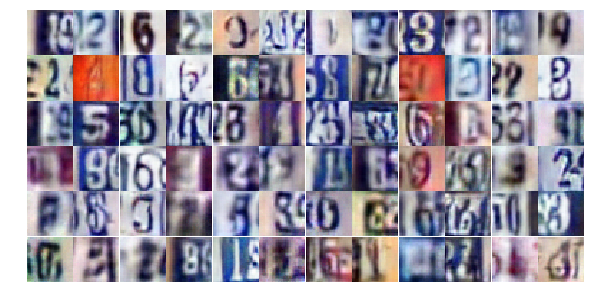

Epoch 20/20... Discriminator Loss: 0.8704... Generator Loss: 0.7515
Epoch 20/20... Discriminator Loss: 0.5251... Generator Loss: 1.2024
Epoch 20/20... Discriminator Loss: 1.2784... Generator Loss: 0.4678
Epoch 20/20... Discriminator Loss: 0.5792... Generator Loss: 1.4458
Epoch 20/20... Discriminator Loss: 0.7866... Generator Loss: 0.9055
Epoch 20/20... Discriminator Loss: 0.6816... Generator Loss: 1.0896
Epoch 20/20... Discriminator Loss: 0.7179... Generator Loss: 0.9271
Epoch 20/20... Discriminator Loss: 1.1632... Generator Loss: 0.5801
Epoch 20/20... Discriminator Loss: 1.0674... Generator Loss: 0.6205
Epoch 20/20... Discriminator Loss: 1.5917... Generator Loss: 0.3633


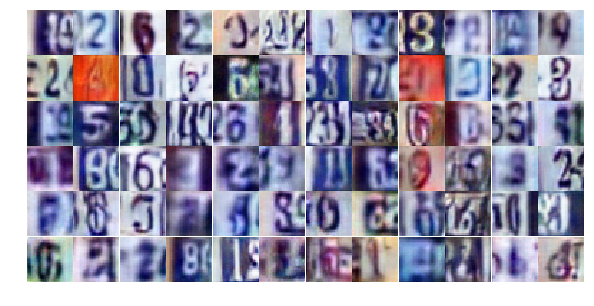

Epoch 20/20... Discriminator Loss: 0.9912... Generator Loss: 0.7026
Epoch 20/20... Discriminator Loss: 0.7946... Generator Loss: 0.9101
Epoch 20/20... Discriminator Loss: 0.9340... Generator Loss: 2.8442
Epoch 20/20... Discriminator Loss: 0.8495... Generator Loss: 0.7947
Epoch 20/20... Discriminator Loss: 1.0742... Generator Loss: 0.6156
Epoch 20/20... Discriminator Loss: 1.3655... Generator Loss: 0.4620
Epoch 20/20... Discriminator Loss: 0.9243... Generator Loss: 0.7077
Epoch 20/20... Discriminator Loss: 0.4560... Generator Loss: 1.6205
Epoch 20/20... Discriminator Loss: 0.5610... Generator Loss: 1.2494
Epoch 20/20... Discriminator Loss: 0.6249... Generator Loss: 1.0750


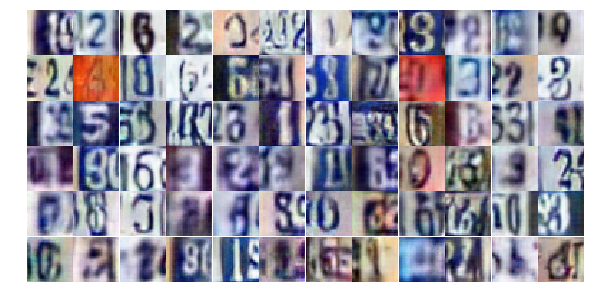

Epoch 20/20... Discriminator Loss: 0.3229... Generator Loss: 2.7139
Epoch 20/20... Discriminator Loss: 0.5526... Generator Loss: 2.3176
Epoch 20/20... Discriminator Loss: 0.5200... Generator Loss: 1.3884
Epoch 20/20... Discriminator Loss: 0.7952... Generator Loss: 1.0893
Epoch 20/20... Discriminator Loss: 0.4217... Generator Loss: 2.2050
Epoch 20/20... Discriminator Loss: 0.4020... Generator Loss: 1.5670


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

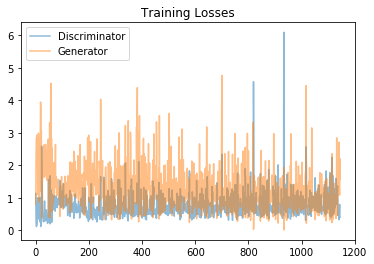

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

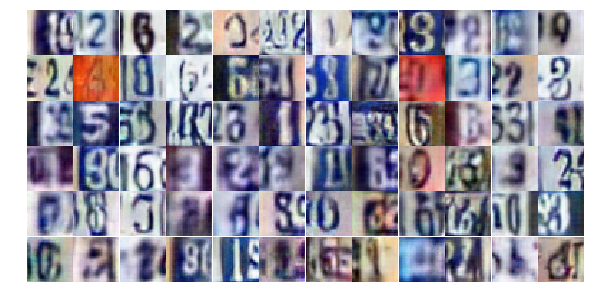

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))